In [1]:

from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
!pip install mediapipe
!pip install opencv-python
!pip install pandas 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.9/33.9 MB 28.8 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
!pip install numpy
!pip install pandas
!pip install keras
!pip install scikit-learn




Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
import numpy as np
import pandas as pd

from keras.layers import LSTM, Dense,Dropout
from keras.models import Sequential

from sklearn.model_selection import train_test_split

# Đọc dữ liệu

puch_df = pd.read_csv("https://raw.githubusercontent.com/Nhathuyy/action_dection_ltsm/main/PUCH.txt")
lie_df = pd.read_csv("https://raw.githubusercontent.com/Nhathuyy/action_dection_ltsm/main/LIE.txt")
sitdown_df = pd.read_csv("https://raw.githubusercontent.com/Nhathuyy/action_dection_ltsm/main/SIT%20DOWN.txt")
uphand_df = pd.read_csv("https://raw.githubusercontent.com/Nhathuyy/action_dection_ltsm/main/Up%20Hand.txt")
natural_df = pd.read_csv("https://raw.githubusercontent.com/Nhathuyy/action_dection_ltsm/main/Natural.txt")


X = []
y = []
no_of_timesteps = 10

dataset = puch_df.iloc[:,1:].values
n_sample = len(dataset)
for i in range(no_of_timesteps, n_sample):
    X.append(dataset[i-no_of_timesteps:i,:])
    y.append(1)

dataset = lie_df.iloc[:,1:].values
n_sample = len(dataset)
for i in range(no_of_timesteps, n_sample):
    X.append(dataset[i-no_of_timesteps:i,:])
    y.append(0)

dataset = sitdown_df.iloc[:,1:].values
n_sample = len(dataset)
for i in range(no_of_timesteps, n_sample):
    X.append(dataset[i-no_of_timesteps:i,:])
    y.append(0)

dataset = uphand_df.iloc[:,1:].values
n_sample = len(dataset)
for i in range(no_of_timesteps, n_sample):
    X.append(dataset[i-no_of_timesteps:i,:])
    y.append(0)

dataset = natural_df.iloc[:,1:].values
n_sample = len(dataset)
for i in range(no_of_timesteps, n_sample):
    X.append(dataset[i-no_of_timesteps:i,:])
    y.append(0)        
X, y = np.array(X), np.array(y)
print(X.shape, y.shape)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

model  = Sequential()
model.add(LSTM(units = 50, return_sequences = True, input_shape = (X.shape[1], X.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(units = 50, return_sequences = True))
model.add(Dropout(0.2))
model.add(LSTM(units = 50, return_sequences = True))
model.add(Dropout(0.2))
model.add(LSTM(units = 50))
model.add(Dropout(0.2))
model.add(Dense(units = 1, activation="sigmoid"))
model.compile(optimizer="adam", metrics = ['accuracy'], loss = "binary_crossentropy")




(635, 10, 132) (635,)


Epoch 1/50
16/16 [==============================] - 21s 416ms/step - loss: 0.5315 - accuracy: 0.8031 - val_loss: 0.6541 - val_accuracy: 0.7008
Epoch 2/50
16/16 [==============================] - 2s 105ms/step - loss: 0.4552 - accuracy: 0.8169 - val_loss: 0.4672 - val_accuracy: 0.7008
Epoch 3/50
16/16 [==============================] - 2s 122ms/step - loss: 0.1760 - accuracy: 0.9409 - val_loss: 0.1830 - val_accuracy: 0.9291
Epoch 4/50
16/16 [==============================] - 1s 71ms/step - loss: 0.0527 - accuracy: 0.9862 - val_loss: 0.1279 - val_accuracy: 0.9764
Epoch 5/50
16/16 [==============================] - 1s 64ms/step - loss: 0.0427 - accuracy: 0.9902 - val_loss: 0.7565 - val_accuracy: 0.8504
Epoch 6/50
16/16 [==============================] - 1s 82ms/step - loss: 0.0558 - accuracy: 0.9862 - val_loss: 0.1341 - val_accuracy: 0.9685
Epoch 7/50
16/16 [==============================] - 1s 77ms/step - loss: 0.0186 - accuracy: 0.9980 - val_loss: 0.0344 - val_accuracy: 0.9921
Epoch 8/5

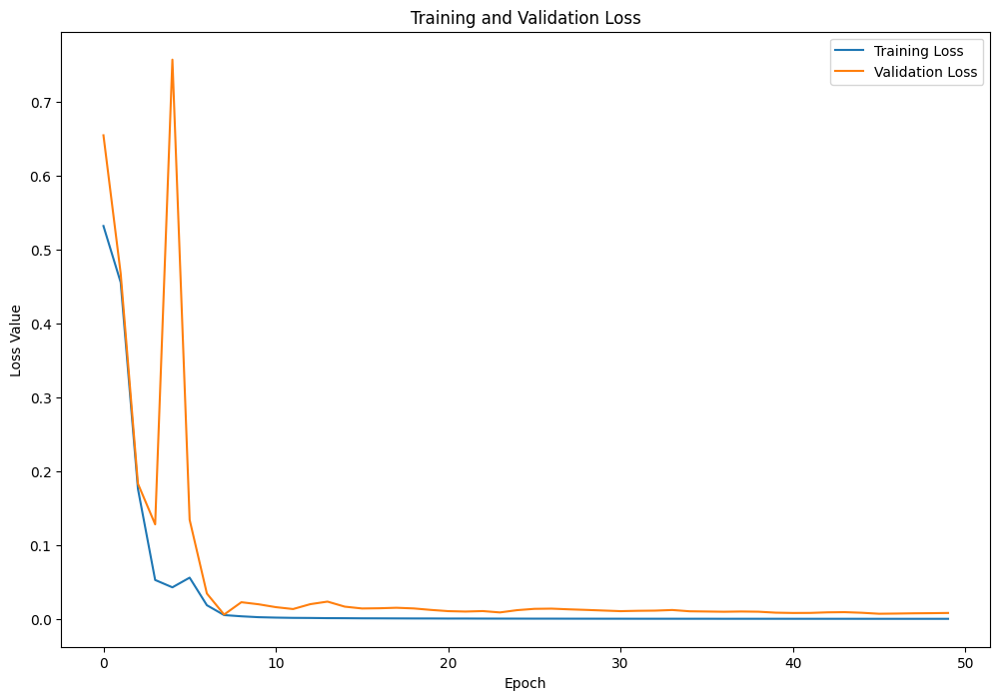

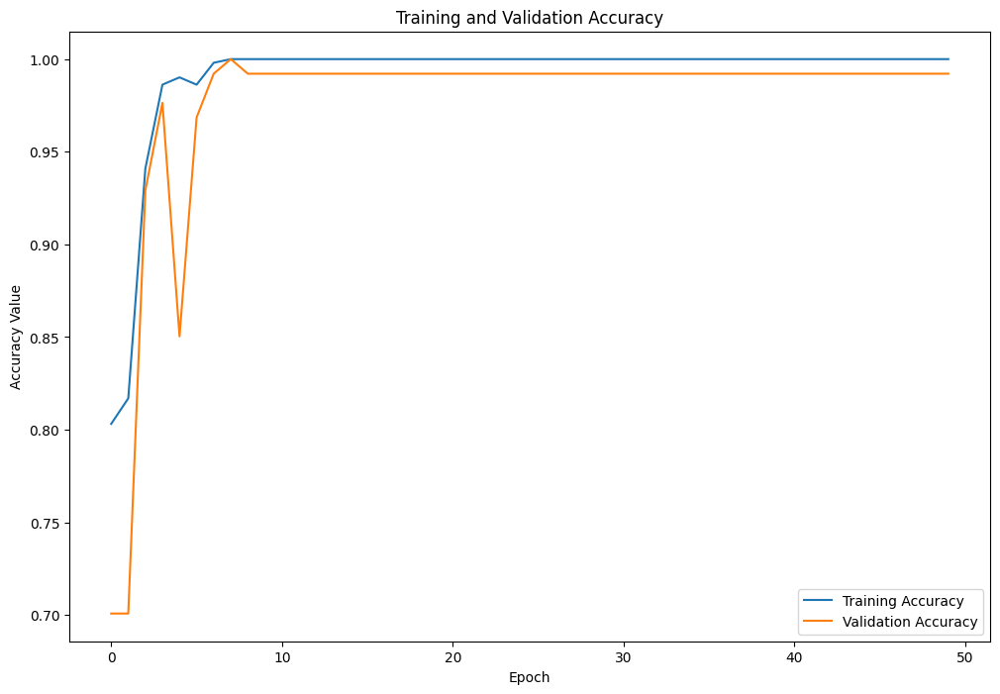

In [5]:
import matplotlib.pyplot as plt

# Huấn luyện model
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test))

# Lưu model
model.save("model.h5")

# Vẽ biểu đồ mất mát (loss) trong quá trình huấn luyện
plt.figure(figsize=(12, 8))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.legend()
plt.show()

# Vẽ biểu đồ độ chính xác (accuracy) trong quá trình huấn luyện
plt.figure(figsize=(12, 8))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy Value')
plt.legend()
plt.show()


In [ ]:
import cv2
import mediapipe as mp
import numpy as np
import threading
import tensorflow as tf

label = "Warmup...."
n_time_steps = 10
lm_list = []

mpPose = mp.solutions.pose
pose = mpPose.Pose()
mpDraw = mp.solutions.drawing_utils

model = tf.keras.models.load_model("/content/model.h5")

video_path_cv = "/content/test.mp4"
cap = cv2.VideoCapture(video_path_cv)

# def make_landmark_timestep(results):
#     c_lm = []
#     for id, lm in enumerate(results.pose_landmarks.landmark):
#         c_lm.append(lm.x)
#         c_lm.append(lm.y)
#         c_lm.append(lm.z)
#         c_lm.append(lm.visibility)
#     return c_lm


# def draw_landmark_on_image(mpDraw, results, img):
#     mpDraw.draw_landmarks(img, results.pose_landmarks, mpPose.POSE_CONNECTIONS)
#     for id, lm in enumerate(results.pose_landmarks.landmark):
#         h, w, c = img.shape
#         print(id, lm)
#         cx, cy = int(lm.x * w), int(lm.y * h)
#         cv2.circle(img, (cx, cy), 5, (255, 0, 0), cv2.FILLED)
#     return img


# def draw_class_on_image(label, img):
#     font = cv2.FONT_HERSHEY_SIMPLEX
#     bottomLeftCornerOfText = (10, 30)
#     fontScale = 1
#     fontColor = (0, 255, 0)
#     thickness = 2
#     lineType = 2
#     cv2.putText(img, label,
#                 bottomLeftCornerOfText,
#                 font,
#                 fontScale,
#                 fontColor,
#                 thickness,
#                 lineType)
#     return img


# def detect(model, lm_list):
#     global label
#     lm_list = np.array(lm_list)
#     lm_list = np.expand_dims(lm_list, axis=0)
#     print(lm_list.shape)
#     results = model.predict(lm_list)
#     print(results)
    
#     # Tạo một danh sách các nhãn tương ứng với số lượng nhãn
#     labels = ["PUNCH", "LIE", "SIT DOWN", "UP HAND", "NATURAL"]
    
#     # Sử dụng hàm np.argmax để tìm chỉ số của giá trị lớn nhất trong kết quả dự đoán
#     # Chỉ số này tương ứng với nhãn của dự đoán
#     predicted_index = np.argmax(results[0])
    
#     # Gán nhãn tương ứng vào biến label
#     label = labels[predicted_index]
    
#     return label



# i = 0
# warmup_frames = 60

# while True:

#     success, img = cap.read()
#     imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#     results = pose.process(imgRGB)
#     i = i + 1
#     if i > warmup_frames:
#         print("Start detect....")

#         if results.pose_landmarks:
#             c_lm = make_landmark_timestep(results)

#             lm_list.append(c_lm)
#             if len(lm_list) == n_time_steps:
#                 # predict
#                 t1 = threading.Thread(target=detect, args=(model, lm_list,))
#                 t1.start()
#                 lm_list = []

#             img = draw_landmark_on_image(mpDraw, results, img)

#     img = draw_class_on_image(label, img)
#     cv2.imshow("Image", img)
#     if cv2.waitKey(1) == ord('q'):
#         break

# cap.release()
# cv2.destroyAllWindows()

In [ ]:

def make_landmark_timestep(results):
    c_lm = []
    for id, lm in enumerate(results.pose_landmarks.landmark):
        c_lm.append(lm.x)
        c_lm.append(lm.y)
        c_lm.append(lm.z)
        c_lm.append(lm.visibility)
    return c_lm

In [ ]:

def draw_landmark_on_image(mpDraw, results, img):
    mpDraw.draw_landmarks(img, results.pose_landmarks, mpPose.POSE_CONNECTIONS)
    for id, lm in enumerate(results.pose_landmarks.landmark):
        h, w, c = img.shape
        print(id, lm)
        cx, cy = int(lm.x * w), int(lm.y * h)
        cv2.circle(img, (cx, cy), 5, (255, 0, 0), cv2.FILLED)
    return img


In [ ]:
def draw_class_on_image(label, img):
    font = cv2.FONT_HERSHEY_SIMPLEX
    bottomLeftCornerOfText = (10, 30)
    fontScale = 1
    fontColor = (0, 255, 0)
    thickness = 2
    lineType = 2
    cv2.putText(img, label,
                bottomLeftCornerOfText,
                font,
                fontScale,
                fontColor,
                thickness,
                lineType)
    return img

In [ ]:
def detect(model, lm_list):
    global label
    lm_list = np.array(lm_list)
    lm_list = np.expand_dims(lm_list, axis=0)
    print(lm_list.shape)
    results = model.predict(lm_list)
    print(results)
    
    # Tạo một danh sách các nhãn tương ứng với số lượng nhãn
    labels = ["PUNCH", "LIE", "SIT DOWN", "UP HAND", "NATURAL"]
    
    # Sử dụng hàm np.argmax để tìm chỉ số của giá trị lớn nhất trong kết quả dự đoán
    # Chỉ số này tương ứng với nhãn của dự đoán
    predicted_index = np.argmax(results[0])
    
    # Gán nhãn tương ứng vào biến label
    label = labels[predicted_index]
    
    return label


In [ ]:

i = 0
warmup_frames = 60

video_path_cv = "test.mp4"
cap = cv2.VideoCapture()

while True:

    success, img = cap.read(video_path_cv)
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = pose.process(imgRGB)
    i = i + 1
    if i > warmup_frames:
        print("Start detect....")

        if results.pose_landmarks:
            c_lm = make_landmark_timestep(results)

            lm_list.append(c_lm)
            if len(lm_list) == n_time_steps:
                # predict
                t1 = threading.Thread(target=detect, args=(model, lm_list,))
                t1.start()
                lm_list = []

            img = draw_landmark_on_image(mpDraw, results, img)

    img = draw_class_on_image(label, img)
    cv2.imshow("Image", img)
    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

error: ignored

In [ ]:
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

i = 0
warmup_frames = 60

# Tải video từ file
cap = cv2.VideoCapture('test.mp4')

# Kiểm tra xem video có được mở không
if not cap.isOpened():
    print("Không thể mở video")

while True:
    # Đọc frame từ video
    success, img = cap.read()

    # Nếu không còn frame để đọc -> kết thúc vòng lặp
    if not success:
        break

    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = pose.process(imgRGB)
    i = i + 1
    if i > warmup_frames:
        print("Start detect....")

        if results.pose_landmarks:
            c_lm = make_landmark_timestep(results)

            lm_list.append(c_lm)
            if len(lm_list) == n_time_steps:
                # predict
                t1 = threading.Thread(target=detect, args=(model, lm_list,))
                t1.start()
                lm_list = []

            img = draw_landmark_on_image(mpDraw, results, img)

    img = draw_class_on_image(label, img)

    # Hiển thị hình ảnh sử dụng matplotlib
    plt.imshow(img)
    plt.show()

    # Thoát vòng lặp khi nhấn 'q'
    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

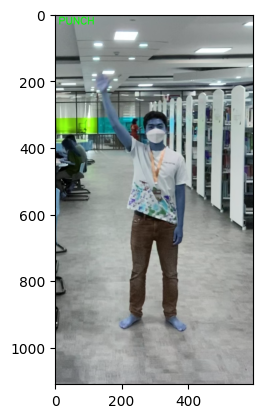

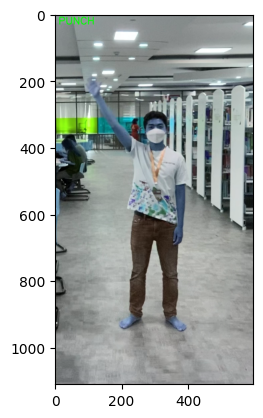

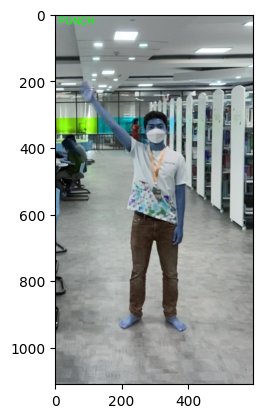

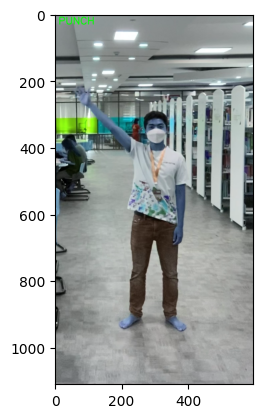

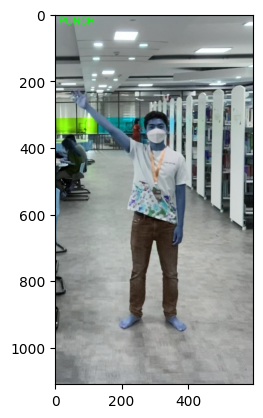

...

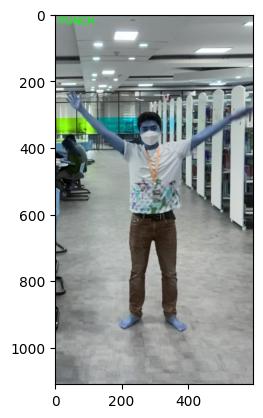

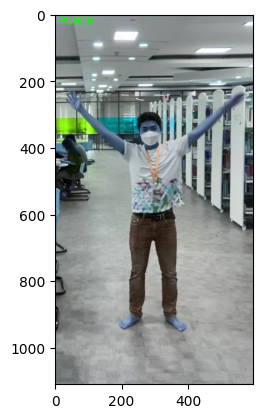

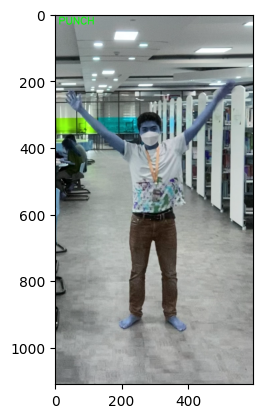

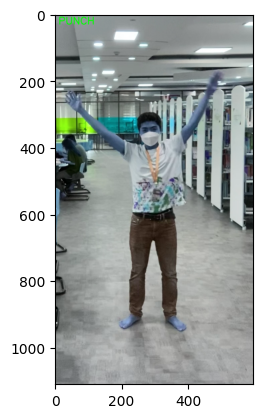

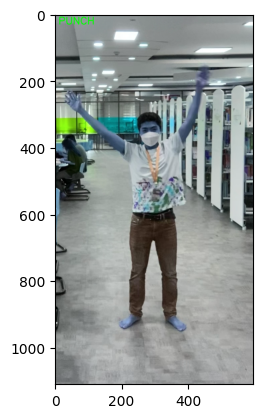

Start detect....
(1, 10, 132)0 x: 0.4748254120349884
y: 0.3304709196090698
z: -0.588284969329834
visibility: 0.999944269657135

1 x: 0.4824506938457489
y: 0.31556668877601624
z: -0.5542371273040771
visibility: 0.9998533129692078

2 x: 0.490493506193161
y: 0.3142751455307007
z: -0.5542165040969849
visibility: 0.999821662902832

3 x: 0.4989780783653259
y: 0.31303778290748596
z: -0.5542965531349182
visibility: 0.9998161792755127

4 x: 0.4608731269836426
y: 0.3181014358997345
z: -0.5496919751167297
visibility: 0.9998335838317871

5 x: 0.45404052734375
y: 0.3186279237270355
z: -0.5497739911079407
visibility: 0.9997745156288147

6 x: 0.4470798969268799
y: 0.319152295589447
z: -0.5497784614562988
visibility: 0.9997437000274658

7 x: 0.5138624906539917
y: 0.3124498724937439
z: -0.3386084735393524
visibility: 0.999724268913269

8 x: 0.44363880157470703
y: 0.32001981139183044
z: -0.32106101512908936
visibility: 0.9996152520179749

9 x: 0.49226051568984985
y: 0.33830687403678894
z: -0.50422614812

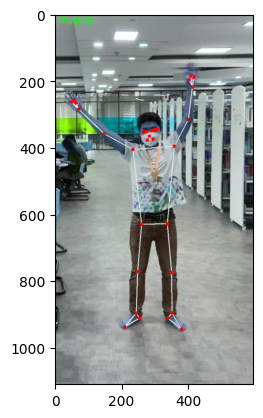

Start detect....
0 x: 0.4767453074455261
y: 0.3298759162425995
z: -0.5362889170646667
visibility: 0.9999403953552246

1 x: 0.4850291907787323
y: 0.31547418236732483
z: -0.5003336668014526
visibility: 0.9998499155044556

2 x: 0.4936459958553314
y: 0.31420812010765076
z: -0.50033038854599
visibility: 0.999814510345459

3 x: 0.5026047825813293
y: 0.31299078464508057
z: -0.5003985166549683
visibility: 0.9998095035552979

4 x: 0.46240055561065674
y: 0.317830890417099
z: -0.496329128742218
visibility: 0.9998340606689453

5 x: 0.4550717771053314
y: 0.3183116614818573
z: -0.4964144825935364
visibility: 0.999774158000946

6 x: 0.4479867219924927
y: 0.3188287913799286
z: -0.4964042007923126
visibility: 0.9997493624687195

7 x: 0.5164491534233093
y: 0.3124600648880005
z: -0.2891820967197418
visibility: 0.9997072815895081

8 x: 0.44392549991607666
y: 0.319927841424942
z: -0.27423861622810364
visibility: 0.9996289610862732

9 x: 0.4946020841598511
y: 0.337617427110672
z: -0.4562225937843323
visibil

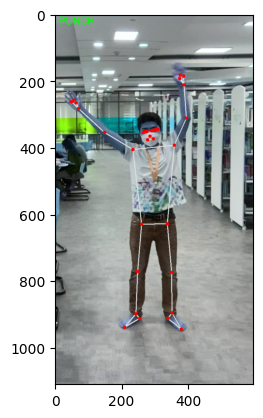

Start detect....
0 x: 0.476985901594162
y: 0.32662883400917053
z: -0.4768739342689514
visibility: 0.9999364614486694

1 x: 0.4853489100933075
y: 0.3139806091785431
z: -0.4382784962654114
visibility: 0.9998462200164795

2 x: 0.49400779604911804
y: 0.3129056692123413
z: -0.4383050203323364
visibility: 0.9998074769973755

3 x: 0.5029283165931702
y: 0.3118465542793274
z: -0.43836233019828796
visibility: 0.9998034834861755

4 x: 0.46270880103111267
y: 0.31667235493659973
z: -0.42889419198036194
visibility: 0.9998323917388916

5 x: 0.45550835132598877
y: 0.3174746036529541
z: -0.42897915840148926
visibility: 0.9997695684432983

6 x: 0.4484555423259735
y: 0.318206250667572
z: -0.4289933443069458
visibility: 0.9997506141662598

7 x: 0.5169229507446289
y: 0.31232598423957825
z: -0.23213998973369598
visibility: 0.9996929168701172

8 x: 0.44417592883110046
y: 0.3198496997356415
z: -0.19032040238380432
visibility: 0.9996346831321716

9 x: 0.49495911598205566
y: 0.33438608050346375
z: -0.4006517827

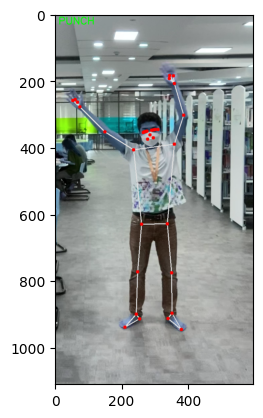

Start detect....
0 x: 0.47549372911453247
y: 0.3262040615081787
z: -0.4473113417625427
visibility: 0.9999301433563232

1 x: 0.4847134053707123
y: 0.3139173686504364
z: -0.41106876730918884
visibility: 0.9998385310173035

2 x: 0.49301162362098694
y: 0.31285569071769714
z: -0.4111105501651764
visibility: 0.9997946619987488

3 x: 0.5016380548477173
y: 0.311821311712265
z: -0.4111801087856293
visibility: 0.9997932314872742

4 x: 0.46206408739089966
y: 0.316536545753479
z: -0.39610591530799866
visibility: 0.9998262524604797

5 x: 0.4548998773097992
y: 0.3173138499259949
z: -0.396200954914093
visibility: 0.9997570514678955

6 x: 0.4479372203350067
y: 0.31804075837135315
z: -0.3962404131889343
visibility: 0.9997448921203613

7 x: 0.5158842206001282
y: 0.31258103251457214
z: -0.22066348791122437
visibility: 0.9996703863143921

8 x: 0.4444553852081299
y: 0.3198842704296112
z: -0.15280334651470184
visibility: 0.9996287822723389

9 x: 0.49319764971733093
y: 0.3334803283214569
z: -0.37699782848358

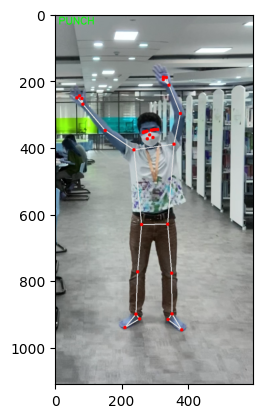

Start detect....
0 x: 0.47550901770591736
y: 0.3262973129749298
z: -0.4425954222679138
visibility: 0.9999191164970398

1 x: 0.4848281145095825
y: 0.3139633238315582
z: -0.4068358838558197
visibility: 0.9998248815536499

2 x: 0.49313247203826904
y: 0.31288376450538635
z: -0.4068724811077118
visibility: 0.9997727870941162

3 x: 0.5017712712287903
y: 0.31184977293014526
z: -0.4069521725177765
visibility: 0.999774694442749

4 x: 0.4620612859725952
y: 0.31679534912109375
z: -0.39347270131111145
visibility: 0.9998137354850769

5 x: 0.4549005627632141
y: 0.31763947010040283
z: -0.3935662508010864
visibility: 0.9997353553771973

6 x: 0.447958767414093
y: 0.31838032603263855
z: -0.39360418915748596
visibility: 0.9997315406799316

7 x: 0.5156105756759644
y: 0.31270283460617065
z: -0.21793672442436218
visibility: 0.9996390342712402

8 x: 0.4444020390510559
y: 0.3200477361679077
z: -0.15632766485214233
visibility: 0.9996166229248047

9 x: 0.4933927357196808
y: 0.33349624276161194
z: -0.37207913398

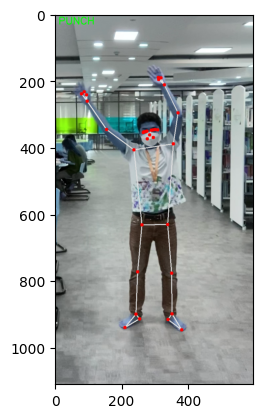

Start detect....
0 x: 0.4756041169166565
y: 0.32520437240600586
z: -0.43520161509513855
visibility: 0.9999101161956787

1 x: 0.48492059111595154
y: 0.31301790475845337
z: -0.3965179920196533
visibility: 0.999814510345459

2 x: 0.49320513010025024
y: 0.3120201528072357
z: -0.39650654792785645
visibility: 0.9997537136077881

3 x: 0.5018694400787354
y: 0.3110834062099457
z: -0.39657512307167053
visibility: 0.9997599720954895

4 x: 0.46204453706741333
y: 0.3161214590072632
z: -0.3887968957424164
visibility: 0.999805748462677

5 x: 0.45448148250579834
y: 0.31709346175193787
z: -0.38889220356941223
visibility: 0.9997208714485168

6 x: 0.44709572196006775
y: 0.31787803769111633
z: -0.38890329003334045
visibility: 0.999725878238678

7 x: 0.5152994394302368
y: 0.31269291043281555
z: -0.20079676806926727
visibility: 0.9996113181114197

8 x: 0.44344642758369446
y: 0.3196980655193329
z: -0.16505372524261475
visibility: 0.9996171593666077

9 x: 0.4935184419155121
y: 0.3326048254966736
z: -0.3629269

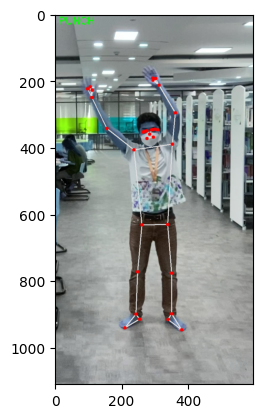

Start detect....
0 x: 0.47570478916168213
y: 0.32376688718795776
z: -0.3863798677921295
visibility: 0.9998962879180908

1 x: 0.48506128787994385
y: 0.31203389167785645
z: -0.34580501914024353
visibility: 0.9997984766960144

2 x: 0.49331849813461304
y: 0.31111761927604675
z: -0.34576907753944397
visibility: 0.9997279644012451

3 x: 0.501880943775177
y: 0.3102859556674957
z: -0.3458234667778015
visibility: 0.9997410178184509

4 x: 0.4619656801223755
y: 0.3153122663497925
z: -0.3427348732948303
visibility: 0.9997894167900085

5 x: 0.4541424810886383
y: 0.3164314925670624
z: -0.34282222390174866
visibility: 0.9996958374977112

6 x: 0.4464118480682373
y: 0.31729355454444885
z: -0.3428312838077545
visibility: 0.9997110962867737

7 x: 0.5137781500816345
y: 0.3129028081893921
z: -0.15347567200660706
visibility: 0.9995774626731873

8 x: 0.4417142868041992
y: 0.31966835260391235
z: -0.1389867067337036
visibility: 0.9996058940887451

9 x: 0.49363744258880615
y: 0.3315609395503998
z: -0.3161396682

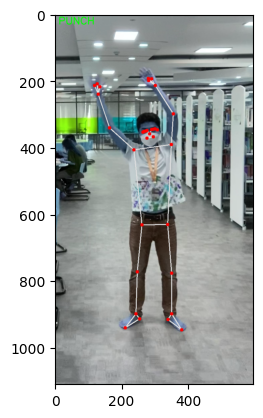

Start detect....
0 x: 0.47534850239753723
y: 0.3229759931564331
z: -0.34953773021698
visibility: 0.9998796582221985

1 x: 0.4847347140312195
y: 0.31152552366256714
z: -0.3095359802246094
visibility: 0.9997764825820923

2 x: 0.49289295077323914
y: 0.3106280565261841
z: -0.30948594212532043
visibility: 0.9996936917304993

3 x: 0.5012711882591248
y: 0.3098386228084564
z: -0.3095479905605316
visibility: 0.9997168183326721

4 x: 0.46133315563201904
y: 0.31496182084083557
z: -0.30383405089378357
visibility: 0.9997654557228088

5 x: 0.4532514810562134
y: 0.3161645829677582
z: -0.3039250075817108
visibility: 0.9996566772460938

6 x: 0.44520071148872375
y: 0.3170560300350189
z: -0.3039315640926361
visibility: 0.9996861219406128

7 x: 0.5119622349739075
y: 0.31296610832214355
z: -0.12384238094091415
visibility: 0.9995293617248535

8 x: 0.4392702877521515
y: 0.3196243345737457
z: -0.09755101054906845
visibility: 0.9995753765106201

9 x: 0.4933796226978302
y: 0.3311782777309418
z: -0.2820100784301

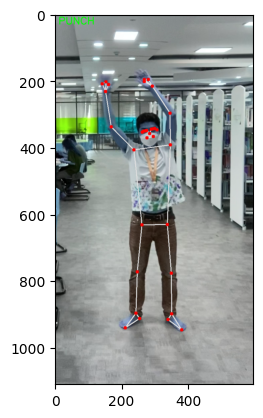

Start detect....
0 x: 0.47385165095329285
y: 0.3232184052467346
z: -0.35033002495765686
visibility: 0.9998536705970764

1 x: 0.48366689682006836
y: 0.3117034137248993
z: -0.310703307390213
visibility: 0.9997429847717285

2 x: 0.49191832542419434
y: 0.31077271699905396
z: -0.3106529116630554
visibility: 0.999643087387085

3 x: 0.5002892017364502
y: 0.3099643588066101
z: -0.3107195794582367
visibility: 0.9996803402900696

4 x: 0.4594879150390625
y: 0.31516921520233154
z: -0.3021591007709503
visibility: 0.999728262424469

5 x: 0.4510965049266815
y: 0.31631290912628174
z: -0.30224546790122986
visibility: 0.9995951056480408

6 x: 0.4428524672985077
y: 0.3171589970588684
z: -0.3022804260253906
visibility: 0.9996437430381775

7 x: 0.5104564428329468
y: 0.3134487271308899
z: -0.1282031387090683
visibility: 0.9994602799415588

8 x: 0.43637385964393616
y: 0.3197842240333557
z: -0.0887560024857521
visibility: 0.9995275139808655

9 x: 0.4919283092021942
y: 0.3316784203052521
z: -0.2840958535671234

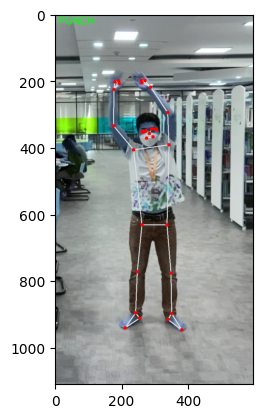

Start detect....
0 x: 0.4739012122154236
y: 0.325733482837677
z: -0.3216792643070221
visibility: 0.9998184442520142

1 x: 0.48372477293014526
y: 0.31310442090034485
z: -0.2835949659347534
visibility: 0.9996917843818665

2 x: 0.4919998347759247
y: 0.3121151030063629
z: -0.283541202545166
visibility: 0.9995591640472412

3 x: 0.5003377199172974
y: 0.311322420835495
z: -0.28361374139785767
visibility: 0.9996209740638733

4 x: 0.4595690369606018
y: 0.31649601459503174
z: -0.27325698733329773
visibility: 0.999674916267395

5 x: 0.4510585069656372
y: 0.31739962100982666
z: -0.2733525037765503
visibility: 0.9995065331459045

6 x: 0.44261234998703003
y: 0.31807592511177063
z: -0.2734094560146332
visibility: 0.9995919466018677

7 x: 0.509453535079956
y: 0.3145018219947815
z: -0.10382669419050217
visibility: 0.9993433952331543

8 x: 0.4354012608528137
y: 0.31977009773254395
z: -0.056179217994213104
visibility: 0.9994780421257019

9 x: 0.4919077157974243
y: 0.3340563476085663
z: -0.256124496459960

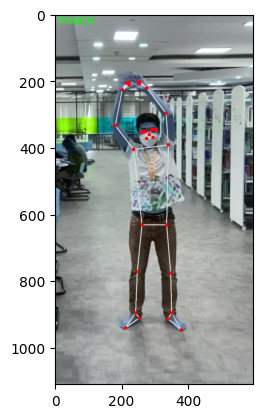

Start detect....
(1, 10, 132)
0 x: 0.47129395604133606
y: 0.32668814063072205
z: -0.31061097979545593
visibility: 0.999777615070343

1 x: 0.4825834631919861
y: 0.3135238587856293
z: -0.27606138586997986
visibility: 0.9996311664581299

2 x: 0.4908689856529236
y: 0.3125658631324768
z: -0.2759995460510254
visibility: 0.9994587898254395

3 x: 0.49907657504081726
y: 0.3118656575679779
z: -0.2760680019855499
visibility: 0.9995598196983337

4 x: 0.4571778476238251
y: 0.31672537326812744
z: -0.26000070571899414
visibility: 0.9996121525764465

5 x: 0.44822457432746887
y: 0.31748390197753906
z: -0.2600913643836975
visibility: 0.9993938207626343

6 x: 0.43957406282424927
y: 0.31806838512420654
z: -0.26019343733787537
visibility: 0.9995328783988953

7 x: 0.5072392225265503
y: 0.31533610820770264
z: -0.10928000509738922
visibility: 0.999207079410553

8 x: 0.4330606758594513
y: 0.3197157084941864
z: -0.034056250005960464
visibility: 0.999401867389679

9 x: 0.48850563168525696
y: 0.3349999487400055
z

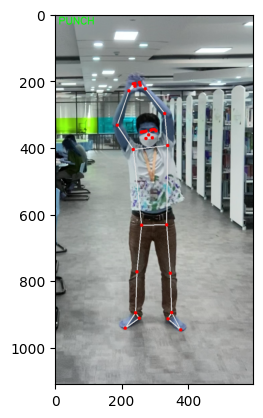

Start detect....
0 x: 0.46861532330513
y: 0.3280479311943054
z: -0.2968537509441376
visibility: 0.9997290372848511

1 x: 0.4808920621871948
y: 0.3147149384021759
z: -0.2656617760658264
visibility: 0.9995660781860352

2 x: 0.4891839623451233
y: 0.3137377202510834
z: -0.26559436321258545
visibility: 0.999351978302002

3 x: 0.49725234508514404
y: 0.3130251467227936
z: -0.26565438508987427
visibility: 0.9994944930076599

4 x: 0.4547216296195984
y: 0.3174917995929718
z: -0.24695123732089996
visibility: 0.9995424747467041

5 x: 0.44562357664108276
y: 0.31795069575309753
z: -0.2470197230577469
visibility: 0.9992627501487732

6 x: 0.4369685649871826
y: 0.3183320164680481
z: -0.24713073670864105
visibility: 0.9994622468948364

7 x: 0.5050095319747925
y: 0.31613168120384216
z: -0.10813233256340027
visibility: 0.9990729689598083

8 x: 0.43160438537597656
y: 0.31982433795928955
z: -0.02001412957906723
visibility: 0.999313235282898

9 x: 0.4854629933834076
y: 0.3359805643558502
z: -0.23920814692974

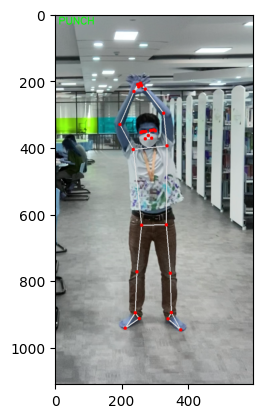

Start detect....
0 x: 0.4677947759628296
y: 0.33076775074005127
z: -0.31378817558288574
visibility: 0.9996749758720398

1 x: 0.4803903102874756
y: 0.3174464702606201
z: -0.2821059226989746
visibility: 0.9994906187057495

2 x: 0.488747775554657
y: 0.31644973158836365
z: -0.2820461392402649
visibility: 0.9992275238037109

3 x: 0.4968411326408386
y: 0.3157084584236145
z: -0.2821304500102997
visibility: 0.9994176030158997

4 x: 0.4535098373889923
y: 0.31953442096710205
z: -0.2652865946292877
visibility: 0.9994639158248901

5 x: 0.4442056119441986
y: 0.3195294141769409
z: -0.2653357982635498
visibility: 0.9991142153739929

6 x: 0.4354178011417389
y: 0.31958067417144775
z: -0.26541852951049805
visibility: 0.9993758797645569

7 x: 0.5047445893287659
y: 0.3184240758419037
z: -0.11953919380903244
visibility: 0.9989148378372192

8 x: 0.4303071200847626
y: 0.3209276497364044
z: -0.04004696384072304
visibility: 0.999200701713562

9 x: 0.4848618507385254
y: 0.33822953701019287
z: -0.253736227750778

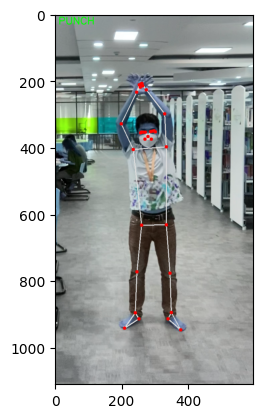

Start detect....
0 x: 0.4679659605026245
y: 0.330622136592865
z: -0.30861783027648926
visibility: 0.9996104836463928

1 x: 0.4804225564002991
y: 0.3173840343952179
z: -0.2755316197872162
visibility: 0.9993972182273865

2 x: 0.48874741792678833
y: 0.3164374530315399
z: -0.27546218037605286
visibility: 0.9990724325180054

3 x: 0.49680277705192566
y: 0.31572210788726807
z: -0.2755407392978668
visibility: 0.9993249773979187

4 x: 0.4534774422645569
y: 0.3194614052772522
z: -0.26097121834754944
visibility: 0.9993664026260376

5 x: 0.444144070148468
y: 0.3194848299026489
z: -0.26104018092155457
visibility: 0.9989412426948547

6 x: 0.43530210852622986
y: 0.31955188512802124
z: -0.2611326575279236
visibility: 0.9992782473564148

7 x: 0.5042693614959717
y: 0.31904298067092896
z: -0.10954868048429489
visibility: 0.9987226724624634

8 x: 0.429529070854187
y: 0.32134923338890076
z: -0.03954122215509415
visibility: 0.9990605711936951

9 x: 0.48500168323516846
y: 0.3382081091403961
z: -0.24732817709

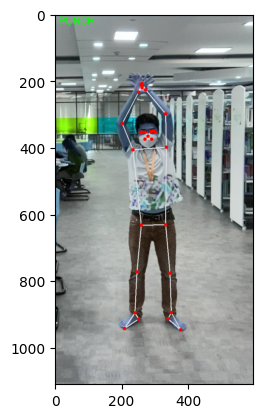

Start detect....
0 x: 0.46791645884513855
y: 0.33032089471817017
z: -0.28894904255867004
visibility: 0.9995670914649963

1 x: 0.4800876975059509
y: 0.3170396387577057
z: -0.2569161355495453
visibility: 0.9993370175361633

2 x: 0.4884302616119385
y: 0.31607264280319214
z: -0.2568516433238983
visibility: 0.9989724159240723

3 x: 0.49647265672683716
y: 0.3153148889541626
z: -0.25693565607070923
visibility: 0.9992640614509583

4 x: 0.4529044032096863
y: 0.31919065117836
z: -0.2423000931739807
visibility: 0.9993016123771667

5 x: 0.44352608919143677
y: 0.31925061345100403
z: -0.24238315224647522
visibility: 0.9988276362419128

6 x: 0.4347275197505951
y: 0.3193347752094269
z: -0.24248476326465607
visibility: 0.9992172122001648

7 x: 0.5034062266349792
y: 0.31891658902168274
z: -0.09548831731081009
visibility: 0.9986099600791931

8 x: 0.4284851849079132
y: 0.3213207721710205
z: -0.024788789451122284
visibility: 0.998982846736908

9 x: 0.48480716347694397
y: 0.338113397359848
z: -0.22922480106

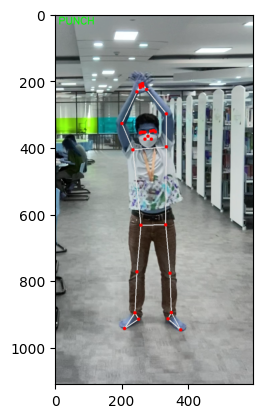

Start detect....
0 x: 0.46800467371940613
y: 0.33019697666168213
z: -0.2865420877933502
visibility: 0.9995529055595398

1 x: 0.4799264967441559
y: 0.3169337213039398
z: -0.25215524435043335
visibility: 0.9993173480033875

2 x: 0.48816272616386414
y: 0.3159777522087097
z: -0.2520827054977417
visibility: 0.9989342093467712

3 x: 0.49610403180122375
y: 0.31523802876472473
z: -0.252165824174881
visibility: 0.9992409348487854

4 x: 0.4530066251754761
y: 0.31911376118659973
z: -0.23946921527385712
visibility: 0.9992855191230774

5 x: 0.44367894530296326
y: 0.31920379400253296
z: -0.23955686390399933
visibility: 0.9987993836402893

6 x: 0.43491697311401367
y: 0.3193170130252838
z: -0.23966966569423676
visibility: 0.9992071390151978

7 x: 0.5030161142349243
y: 0.31876930594444275
z: -0.08469423651695251
visibility: 0.9985765814781189

8 x: 0.4284959137439728
y: 0.3212968409061432
z: -0.02262231335043907
visibility: 0.9989871382713318

9 x: 0.48485544323921204
y: 0.3380352258682251
z: -0.224760

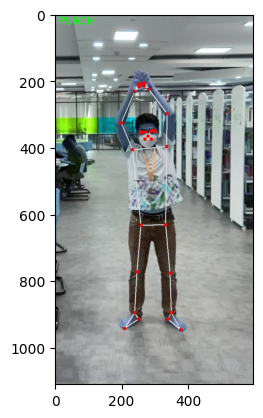

Start detect....
0 x: 0.4692779779434204
y: 0.3298335075378418
z: -0.3032224476337433
visibility: 0.9995130300521851

1 x: 0.48052552342414856
y: 0.3164215087890625
z: -0.26841890811920166
visibility: 0.9992517828941345

2 x: 0.4886265695095062
y: 0.31536728143692017
z: -0.2683560252189636
visibility: 0.9988301396369934

3 x: 0.4964112639427185
y: 0.31451576948165894
z: -0.26843884587287903
visibility: 0.9991632699966431

4 x: 0.45391324162483215
y: 0.31890398263931274
z: -0.2559188902378082
visibility: 0.999217689037323

5 x: 0.44451904296875
y: 0.3190743625164032
z: -0.2559981346130371
visibility: 0.9986856579780579

6 x: 0.4357273280620575
y: 0.31921911239624023
z: -0.2560877799987793
visibility: 0.9991283416748047

7 x: 0.5032274723052979
y: 0.31746628880500793
z: -0.09209392964839935
visibility: 0.9984562397003174

8 x: 0.4286578893661499
y: 0.3210592269897461
z: -0.034574784338474274
visibility: 0.9989120960235596

9 x: 0.4861532151699066
y: 0.3377155065536499
z: -0.2400366067886

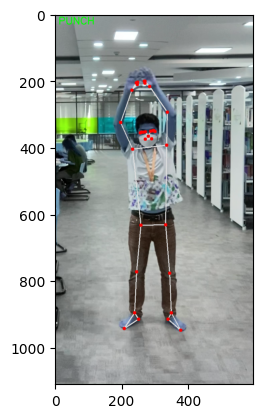

Start detect....
0 x: 0.4699976444244385
y: 0.3271483778953552
z: -0.3222499489784241
visibility: 0.9995195865631104

1 x: 0.48062917590141296
y: 0.3140808343887329
z: -0.276464581489563
visibility: 0.9992614984512329

2 x: 0.4886530935764313
y: 0.3130643665790558
z: -0.2763887047767639
visibility: 0.9988477826118469

3 x: 0.4964298605918884
y: 0.31222617626190186
z: -0.27646544575691223
visibility: 0.9991714954376221

4 x: 0.45501574873924255
y: 0.31697994470596313
z: -0.26552775502204895
visibility: 0.9992244839668274

5 x: 0.44607535004615784
y: 0.3174942433834076
z: -0.2655513882637024
visibility: 0.9986989498138428

6 x: 0.43784916400909424
y: 0.317850261926651
z: -0.26554346084594727
visibility: 0.9991277456283569

7 x: 0.50333571434021
y: 0.315514475107193
z: -0.10015693306922913
visibility: 0.9984899759292603

8 x: 0.4292353689670563
y: 0.319681853055954
z: -0.04171764850616455
visibility: 0.9989264011383057

9 x: 0.48652368783950806
y: 0.33516523241996765
z: -0.251573652029037

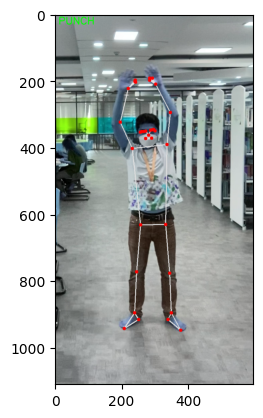

Start detect....
0 x: 0.4711637496948242
y: 0.3269166946411133
z: -0.33874788880348206
visibility: 0.9995365738868713

1 x: 0.4811505675315857
y: 0.31401073932647705
z: -0.2876776456832886
visibility: 0.9992828965187073

2 x: 0.48902836441993713
y: 0.3130146861076355
z: -0.2876148223876953
visibility: 0.9988793134689331

3 x: 0.4968336522579193
y: 0.3121749758720398
z: -0.28766319155693054
visibility: 0.9991850256919861

4 x: 0.4570770263671875
y: 0.3168400824069977
z: -0.28112003207206726
visibility: 0.9992504715919495

5 x: 0.4488270878791809
y: 0.3173801302909851
z: -0.28115400671958923
visibility: 0.9987497329711914

6 x: 0.44117558002471924
y: 0.3177586793899536
z: -0.2811362147331238
visibility: 0.9991581439971924

7 x: 0.5042328238487244
y: 0.315439373254776
z: -0.10163237154483795
visibility: 0.9985213875770569

8 x: 0.4301891326904297
y: 0.31942543387413025
z: -0.04462491720914841
visibility: 0.9989705085754395

9 x: 0.4871939420700073
y: 0.33498114347457886
z: -0.262031465768

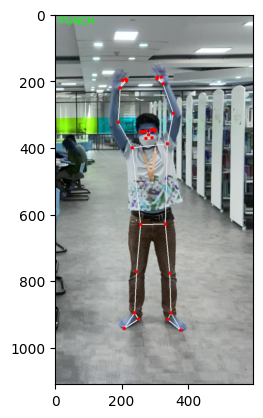

Start detect....
0 x: 0.47029393911361694
y: 0.3284209966659546
z: -0.40941816568374634
visibility: 0.9995665550231934

1 x: 0.48023343086242676
y: 0.31552886962890625
z: -0.3669084310531616
visibility: 0.9993258118629456

2 x: 0.48820653557777405
y: 0.3144396245479584
z: -0.3668590486049652
visibility: 0.9989449977874756

3 x: 0.496168851852417
y: 0.3134631812572479
z: -0.36693131923675537
visibility: 0.999225914478302

4 x: 0.45673128962516785
y: 0.31810230016708374
z: -0.35777854919433594
visibility: 0.9993000030517578

5 x: 0.4486437737941742
y: 0.31853559613227844
z: -0.35780957341194153
visibility: 0.9988348484039307

6 x: 0.44107699394226074
y: 0.31883704662323
z: -0.3578123152256012
visibility: 0.9992130398750305

7 x: 0.5042506456375122
y: 0.31564947962760925
z: -0.16602791845798492
visibility: 0.9985918998718262

8 x: 0.4301355481147766
y: 0.3195239007472992
z: -0.11805213987827301
visibility: 0.9990416169166565

9 x: 0.4864848554134369
y: 0.335977166891098
z: -0.333727389574

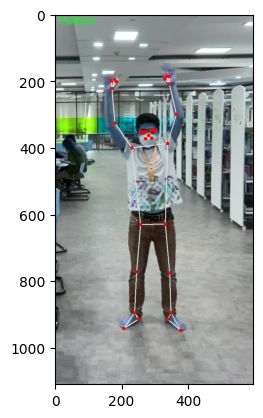

Start detect....
(1, 10, 132)
0 x: 0.4693615734577179
y: 0.329335480928421
z: -0.4953556954860687
visibility: 0.9996011257171631

1 x: 0.47924286127090454
y: 0.3163716495037079
z: -0.458511620759964
visibility: 0.9993782043457031

2 x: 0.48727723956108093
y: 0.31528010964393616
z: -0.4584275782108307
visibility: 0.9990274310112

3 x: 0.4953593909740448
y: 0.31432077288627625
z: -0.4585231840610504
visibility: 0.9992822408676147

4 x: 0.4565443992614746
y: 0.31868910789489746
z: -0.44731467962265015
visibility: 0.9993568658828735

5 x: 0.44863513112068176
y: 0.319076269865036
z: -0.447355180978775
visibility: 0.9989310503005981

6 x: 0.44112133979797363
y: 0.31939399242401123
z: -0.447323739528656
visibility: 0.9992759227752686

7 x: 0.5042963624000549
y: 0.3160141110420227
z: -0.2655729055404663
visibility: 0.9986912608146667

8 x: 0.43038398027420044
y: 0.31993383169174194
z: -0.21280711889266968
visibility: 0.9991193413734436

9 x: 0.4858705699443817
y: 0.33674582839012146
z: -0.4233

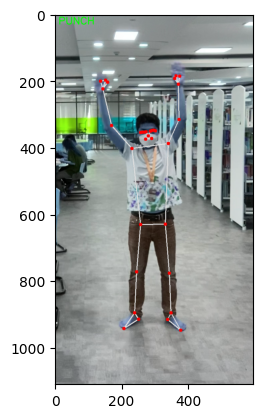

Start detect....
0 x: 0.46975672245025635
y: 0.32938334345817566
z: -0.5354917645454407
visibility: 0.9996336102485657

1 x: 0.4794085621833801
y: 0.3163565993309021
z: -0.4980509281158447
visibility: 0.9994251728057861

2 x: 0.4874333143234253
y: 0.31529131531715393
z: -0.49798011779785156
visibility: 0.9991028904914856

3 x: 0.4955463707447052
y: 0.3143749535083771
z: -0.49809613823890686
visibility: 0.9993322491645813

4 x: 0.45690298080444336
y: 0.3186679184436798
z: -0.4927612841129303
visibility: 0.9994082450866699

5 x: 0.4491894543170929
y: 0.3190564811229706
z: -0.4927993416786194
visibility: 0.9990193247795105

6 x: 0.44183120131492615
y: 0.3193758726119995
z: -0.49274325370788574
visibility: 0.9993329644203186

7 x: 0.5046178102493286
y: 0.31606316566467285
z: -0.2905917465686798
visibility: 0.9987799525260925

8 x: 0.43075883388519287
y: 0.3199474513530731
z: -0.2663402557373047
visibility: 0.9991908669471741

9 x: 0.48651808500289917
y: 0.3368527293205261
z: -0.45683458447

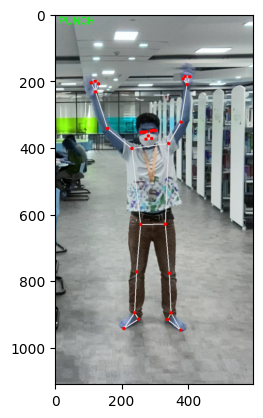

Start detect....
0 x: 0.46978339552879333
y: 0.32936379313468933
z: -0.5406565070152283
visibility: 0.9996652603149414

1 x: 0.4793325364589691
y: 0.31633585691452026
z: -0.5058887004852295
visibility: 0.9994707107543945

2 x: 0.4873482584953308
y: 0.3152959644794464
z: -0.5058079957962036
visibility: 0.9991762042045593

3 x: 0.4954785704612732
y: 0.3144276440143585
z: -0.5059326887130737
visibility: 0.9993816614151001

4 x: 0.4569399058818817
y: 0.31854110956192017
z: -0.49998772144317627
visibility: 0.9994577169418335

5 x: 0.44950494170188904
y: 0.31888458132743835
z: -0.5000259876251221
visibility: 0.9991040825843811

6 x: 0.44259414076805115
y: 0.31920212507247925
z: -0.499961793422699
visibility: 0.9993878602981567

7 x: 0.5046516060829163
y: 0.31598514318466187
z: -0.29917147755622864
visibility: 0.998870313167572

8 x: 0.4325692057609558
y: 0.31978294253349304
z: -0.2739047706127167
visibility: 0.9992588758468628

9 x: 0.4865364134311676
y: 0.3368498980998993
z: -0.461549133062

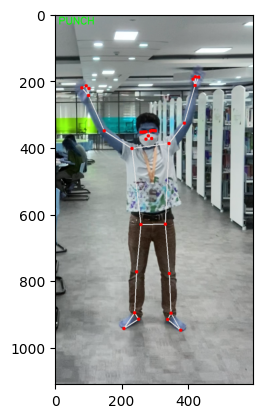

Start detect....
0 x: 0.46866798400878906
y: 0.3327617049217224
z: -0.6522524356842041
visibility: 0.9996953010559082

1 x: 0.4786663055419922
y: 0.318715900182724
z: -0.6269592642784119
visibility: 0.9995147585868835

2 x: 0.48693498969078064
y: 0.31754550337791443
z: -0.6268272399902344
visibility: 0.9992472529411316

3 x: 0.4952482581138611
y: 0.31653985381126404
z: -0.626948893070221
visibility: 0.9994301199913025

4 x: 0.45553311705589294
y: 0.3207073509693146
z: -0.6235519051551819
visibility: 0.999505341053009

5 x: 0.4481680989265442
y: 0.3209048807621002
z: -0.623609185218811
visibility: 0.9991852641105652

6 x: 0.44129815697669983
y: 0.3211238980293274
z: -0.6234877705574036
visibility: 0.9994404315948486

7 x: 0.5045847296714783
y: 0.31723326444625854
z: -0.4133074879646301
visibility: 0.9989633560180664

8 x: 0.43173354864120483
y: 0.3210793137550354
z: -0.4014270007610321
visibility: 0.9993241429328918

9 x: 0.4858334958553314
y: 0.3402731120586395
z: -0.5649077892303467
v

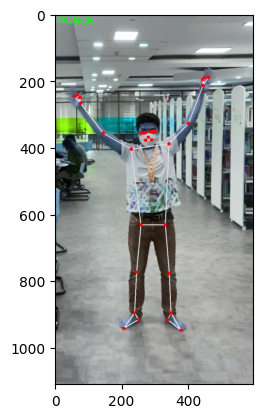

Start detect....
0 x: 0.46860405802726746
y: 0.3334660232067108
z: -0.5672189593315125
visibility: 0.9997220039367676

1 x: 0.47857430577278137
y: 0.3190828263759613
z: -0.5367758870124817
visibility: 0.99955153465271

2 x: 0.4868210256099701
y: 0.3179328739643097
z: -0.5367012023925781
visibility: 0.9993079304695129

3 x: 0.4951408803462982
y: 0.3169671297073364
z: -0.5368281602859497
visibility: 0.9994695782661438

4 x: 0.4554797112941742
y: 0.3210621178150177
z: -0.5329951643943787
visibility: 0.9995458722114563

5 x: 0.44814521074295044
y: 0.32128146290779114
z: -0.5330339670181274
visibility: 0.9992560148239136

6 x: 0.44128331542015076
y: 0.3215371370315552
z: -0.5329529643058777
visibility: 0.9994857311248779

7 x: 0.5045105814933777
y: 0.3176550269126892
z: -0.32644209265708923
visibility: 0.9990409016609192

8 x: 0.43174099922180176
y: 0.32152602076530457
z: -0.31031063199043274
visibility: 0.9993811249732971

9 x: 0.4855988919734955
y: 0.34119024872779846
z: -0.48394006490707

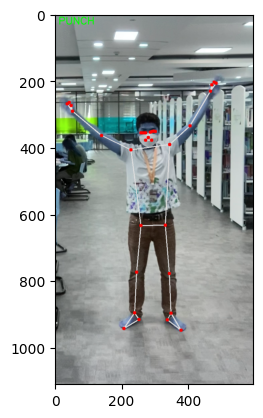

Start detect....
0 x: 0.46833914518356323
y: 0.3333372175693512
z: -0.6032097339630127
visibility: 0.9997478127479553

1 x: 0.4783060848712921
y: 0.3186064660549164
z: -0.5758290886878967
visibility: 0.9995900988578796

2 x: 0.4866476356983185
y: 0.31754904985427856
z: -0.5756992101669312
visibility: 0.9993690252304077

3 x: 0.49500882625579834
y: 0.31669697165489197
z: -0.5757652521133423
visibility: 0.9995124340057373

4 x: 0.4549630284309387
y: 0.32077425718307495
z: -0.5727083086967468
visibility: 0.9995875358581543

5 x: 0.44763973355293274
y: 0.32112234830856323
z: -0.5728020071983337
visibility: 0.9993263483047485

6 x: 0.44080162048339844
y: 0.321483314037323
z: -0.5727342963218689
visibility: 0.9995329976081848

7 x: 0.5045944452285767
y: 0.31762540340423584
z: -0.35576313734054565
visibility: 0.9991248250007629

8 x: 0.431543231010437
y: 0.32157933712005615
z: -0.34916260838508606
visibility: 0.9994387626647949

9 x: 0.48560962080955505
y: 0.3412332832813263
z: -0.51598912477

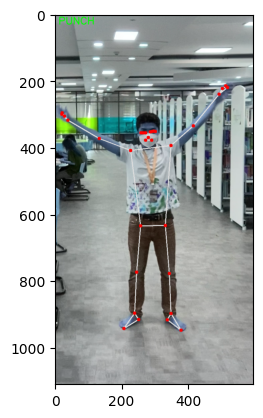

Start detect....
0 x: 0.4683457016944885
y: 0.33344969153404236
z: -0.5805513262748718
visibility: 0.9997711777687073

1 x: 0.47830936312675476
y: 0.3186810314655304
z: -0.5449807643890381
visibility: 0.9996248483657837

2 x: 0.486637145280838
y: 0.3176823556423187
z: -0.5447752475738525
visibility: 0.9994245767593384

3 x: 0.49498727917671204
y: 0.3168864846229553
z: -0.5448113083839417
visibility: 0.9995519518852234

4 x: 0.45514628291130066
y: 0.32081055641174316
z: -0.5347402095794678
visibility: 0.9996245503425598

5 x: 0.4481012225151062
y: 0.32119253277778625
z: -0.5348683595657349
visibility: 0.9993889331817627

6 x: 0.4415290355682373
y: 0.3215927481651306
z: -0.5348765850067139
visibility: 0.999574601650238

7 x: 0.5048201680183411
y: 0.318118155002594
z: -0.35412290692329407
visibility: 0.999200165271759

8 x: 0.43213340640068054
y: 0.32216206192970276
z: -0.30445706844329834
visibility: 0.999489963054657

9 x: 0.48567014932632446
y: 0.34167739748954773
z: -0.509957730770111

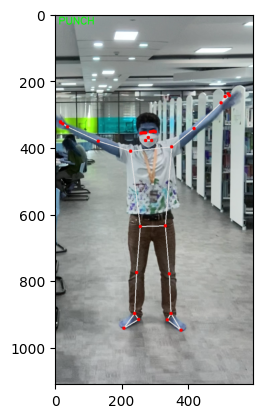

Start detect....
0 x: 0.4703276455402374
y: 0.3367196321487427
z: -0.5676811337471008
visibility: 0.9997915625572205

1 x: 0.48092758655548096
y: 0.32198667526245117
z: -0.5449160933494568
visibility: 0.9996529221534729

2 x: 0.48927244544029236
y: 0.32123056054115295
z: -0.5448054671287537
visibility: 0.9994707107543945

3 x: 0.49746182560920715
y: 0.3205311894416809
z: -0.5449116230010986
visibility: 0.999582827091217

4 x: 0.4569694399833679
y: 0.32326802611351013
z: -0.5410197377204895
visibility: 0.9996562600135803

5 x: 0.4495489001274109
y: 0.3234602212905884
z: -0.5410473942756653
visibility: 0.9994432926177979

6 x: 0.4426037669181824
y: 0.3236787021160126
z: -0.5409646034240723
visibility: 0.9996098279953003

7 x: 0.5090210437774658
y: 0.32026559114456177
z: -0.3426118493080139
visibility: 0.999264657497406

8 x: 0.43265533447265625
y: 0.32321321964263916
z: -0.33043310046195984
visibility: 0.9995346069335938

9 x: 0.48840412497520447
y: 0.3452984094619751
z: -0.4864393472671

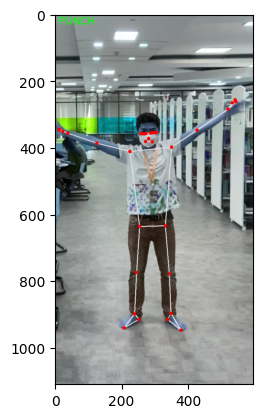

Start detect....
0 x: 0.47078585624694824
y: 0.33640944957733154
z: -0.6068407893180847
visibility: 0.999809205532074

1 x: 0.4815683960914612
y: 0.32187870144844055
z: -0.5768558979034424
visibility: 0.9996725916862488

2 x: 0.48998746275901794
y: 0.3211800158023834
z: -0.5768294334411621
visibility: 0.9995067715644836

3 x: 0.49826422333717346
y: 0.3205288350582123
z: -0.5769595503807068
visibility: 0.9996035099029541

4 x: 0.45773088932037354
y: 0.32314810156822205
z: -0.5779739618301392
visibility: 0.99968022108078

5 x: 0.4504696726799011
y: 0.32336482405662537
z: -0.5779967308044434
visibility: 0.9994873404502869

6 x: 0.4435957968235016
y: 0.32360267639160156
z: -0.577907919883728
visibility: 0.9996355772018433

7 x: 0.5107977390289307
y: 0.32045048475265503
z: -0.3478965759277344
visibility: 0.999313473701477

8 x: 0.43360328674316406
y: 0.3232388198375702
z: -0.3550875186920166
visibility: 0.999569296836853

9 x: 0.4888598620891571
y: 0.34496644139289856
z: -0.5156762599945068

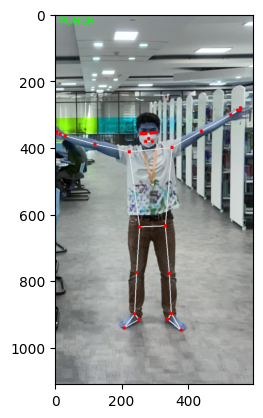

Start detect....
0 x: 0.47067052125930786
y: 0.33573663234710693
z: -0.5212620496749878
visibility: 0.9998262524604797

1 x: 0.481387197971344
y: 0.3213178515434265
z: -0.49512889981269836
visibility: 0.999695897102356

2 x: 0.4897438883781433
y: 0.32066842913627625
z: -0.4950886070728302
visibility: 0.9995453357696533

3 x: 0.49801427125930786
y: 0.32006439566612244
z: -0.49515384435653687
visibility: 0.9996297955513

4 x: 0.45775291323661804
y: 0.32273826003074646
z: -0.49427732825279236
visibility: 0.9997063875198364

5 x: 0.45062410831451416
y: 0.323050856590271
z: -0.4943031370639801
visibility: 0.9995324015617371

6 x: 0.4439539611339569
y: 0.3233864903450012
z: -0.49420979619026184
visibility: 0.9996645450592041

7 x: 0.5107893347740173
y: 0.32030999660491943
z: -0.2864360809326172
visibility: 0.9993691444396973

8 x: 0.4347127079963684
y: 0.32317429780960083
z: -0.29163122177124023
visibility: 0.9996055364608765

9 x: 0.4887538552284241
y: 0.3441801369190216
z: -0.4399839639663

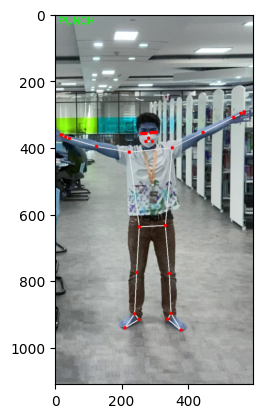

Start detect....
(1, 10, 132)
0 x: 0.47072309255599976
y: 0.3325903117656708
z: -0.5225890278816223
visibility: 0.9998406171798706

1 x: 0.4815099835395813
y: 0.31873828172683716
z: -0.49605152010917664
visibility: 0.9997113943099976

2 x: 0.4898163378238678
y: 0.31827864050865173
z: -0.49599984288215637
visibility: 0.9995747208595276

3 x: 0.4980544149875641
y: 0.31787970662117004
z: -0.49607008695602417
visibility: 0.999646782875061

4 x: 0.45834821462631226
y: 0.3199717700481415
z: -0.4950041174888611
visibility: 0.9997251629829407

5 x: 0.45137032866477966
y: 0.32037240266799927
z: -0.49500900506973267
visibility: 0.9995676279067993

6 x: 0.4448048174381256
y: 0.3208044767379761
z: -0.49491584300994873
visibility: 0.9996843338012695

7 x: 0.5110830664634705
y: 0.31952232122421265
z: -0.2841067314147949
visibility: 0.9994089007377625

8 x: 0.4350762963294983
y: 0.32219600677490234
z: -0.29021432995796204
visibility: 0.9996320605278015

9 x: 0.4887249767780304
y: 0.3421001136302948
z

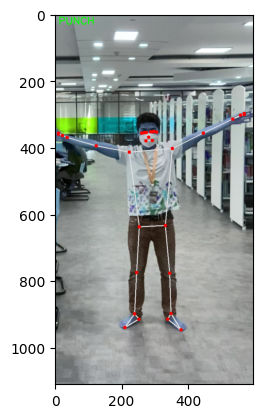

Start detect....
0 x: 0.4707689881324768
y: 0.3322991132736206
z: -0.5136604309082031
visibility: 0.9998539090156555

1 x: 0.481879323720932
y: 0.31867077946662903
z: -0.48386162519454956
visibility: 0.9997264742851257

2 x: 0.4901985228061676
y: 0.3182496428489685
z: -0.48385247588157654
visibility: 0.9996020793914795

3 x: 0.49834272265434265
y: 0.31786566972732544
z: -0.48393315076828003
visibility: 0.9996635913848877

4 x: 0.4586983919143677
y: 0.31978002190589905
z: -0.4852182865142822
visibility: 0.9997432231903076

5 x: 0.4516468048095703
y: 0.32011333107948303
z: -0.4852035343647003
visibility: 0.9996005892753601

6 x: 0.4450165331363678
y: 0.32045477628707886
z: -0.4851146340370178
visibility: 0.9997038245201111

7 x: 0.5117773413658142
y: 0.3195402920246124
z: -0.27268484234809875
visibility: 0.9994469881057739

8 x: 0.4353531301021576
y: 0.32203593850135803
z: -0.28424397110939026
visibility: 0.9996569752693176

9 x: 0.4887182116508484
y: 0.34206050634384155
z: -0.4316083788

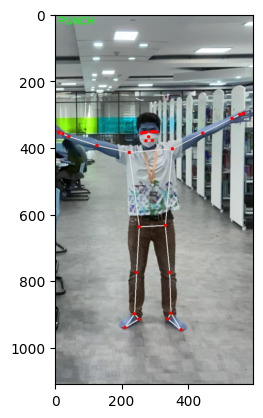

Start detect....
0 x: 0.47056323289871216
y: 0.3306471109390259
z: -0.5582594871520996
visibility: 0.9998661279678345

1 x: 0.481868714094162
y: 0.317273885011673
z: -0.526064395904541
visibility: 0.9997403621673584

2 x: 0.4901881814002991
y: 0.3170604407787323
z: -0.5260671377182007
visibility: 0.999627411365509

3 x: 0.4983305335044861
y: 0.3168894648551941
z: -0.5261616706848145
visibility: 0.9996795058250427

4 x: 0.458721786737442
y: 0.31769585609436035
z: -0.5262987017631531
visibility: 0.9997594356536865

5 x: 0.4516970217227936
y: 0.31771335005760193
z: -0.526306688785553
visibility: 0.9996302127838135

6 x: 0.44509825110435486
y: 0.31779226660728455
z: -0.5262531638145447
visibility: 0.9997209310531616

7 x: 0.511986494064331
y: 0.31934213638305664
z: -0.3093326985836029
visibility: 0.9994815587997437

8 x: 0.4355544447898865
y: 0.3204302489757538
z: -0.3119784891605377
visibility: 0.9996784925460815

9 x: 0.48834091424942017
y: 0.3412012457847595
z: -0.47470706701278687
visi

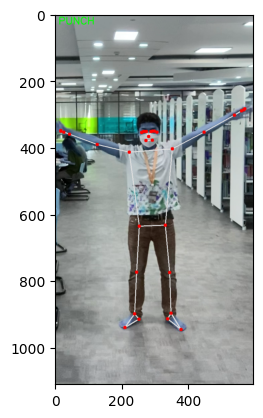

Start detect....
0 x: 0.470455139875412
y: 0.32832106947898865
z: -0.5479380488395691
visibility: 0.9998779892921448

1 x: 0.481853723526001
y: 0.3149682879447937
z: -0.5137048959732056
visibility: 0.9997596740722656

2 x: 0.49017468094825745
y: 0.31486234068870544
z: -0.5137381553649902
visibility: 0.9996568560600281

3 x: 0.4983178377151489
y: 0.31483256816864014
z: -0.5138250589370728
visibility: 0.9997017979621887

4 x: 0.4587584137916565
y: 0.31493955850601196
z: -0.513495683670044
visibility: 0.9997791051864624

5 x: 0.45179539918899536
y: 0.3147285580635071
z: -0.5135151743888855
visibility: 0.9996623992919922

6 x: 0.4452919661998749
y: 0.3146282434463501
z: -0.5134720206260681
visibility: 0.9997431635856628

7 x: 0.5120559334754944
y: 0.31797927618026733
z: -0.2890581786632538
visibility: 0.9995239973068237

8 x: 0.43610864877700806
y: 0.31788888573646545
z: -0.29033246636390686
visibility: 0.9997053742408752

9 x: 0.48827725648880005
y: 0.3393714725971222
z: -0.46187311410903

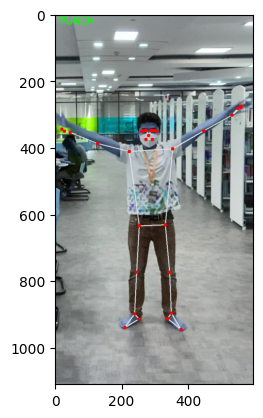

Start detect....
0 x: 0.4707844853401184
y: 0.3245930075645447
z: -0.5075416564941406
visibility: 0.9998875856399536

1 x: 0.48195797204971313
y: 0.31201836466789246
z: -0.46981924772262573
visibility: 0.9997729659080505

2 x: 0.49018076062202454
y: 0.31197473406791687
z: -0.46987995505332947
visibility: 0.999678373336792

3 x: 0.4983087182044983
y: 0.31201687455177307
z: -0.47001320123672485
visibility: 0.9997166991233826

4 x: 0.45976734161376953
y: 0.3118031919002533
z: -0.47097334265708923
visibility: 0.999793529510498

5 x: 0.45320773124694824
y: 0.3115522265434265
z: -0.47097623348236084
visibility: 0.9996873140335083

6 x: 0.4469543993473053
y: 0.31142306327819824
z: -0.4709467589855194
visibility: 0.9997594356536865

7 x: 0.5119829773902893
y: 0.31577393412590027
z: -0.24350124597549438
visibility: 0.9995529055595398

8 x: 0.43757107853889465
y: 0.31549981236457825
z: -0.24875882267951965
visibility: 0.9997250437736511

9 x: 0.4883524179458618
y: 0.33608174324035645
z: -0.42107

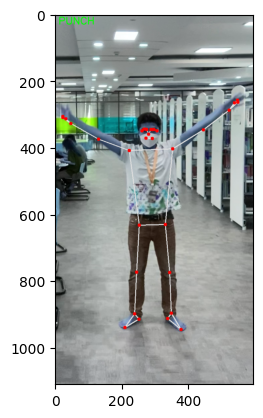

Start detect....
0 x: 0.4708767533302307
y: 0.3224093019962311
z: -0.4812212884426117
visibility: 0.999896764755249

1 x: 0.48195257782936096
y: 0.31020447611808777
z: -0.44362175464630127
visibility: 0.9997870326042175

2 x: 0.4901501536369324
y: 0.3101028501987457
z: -0.44366440176963806
visibility: 0.9997004270553589

3 x: 0.49825507402420044
y: 0.3101186156272888
z: -0.44379305839538574
visibility: 0.9997330904006958

4 x: 0.4599691331386566
y: 0.3103424310684204
z: -0.4409169852733612
visibility: 0.9998075366020203

5 x: 0.45357614755630493
y: 0.3102693259716034
z: -0.44092482328414917
visibility: 0.999710738658905

6 x: 0.4473896920681
y: 0.3103053569793701
z: -0.44090700149536133
visibility: 0.9997751116752625

7 x: 0.5119651556015015
y: 0.3143369257450104
z: -0.22792291641235352
visibility: 0.999582052230835

8 x: 0.43849825859069824
y: 0.31474569439888
z: -0.21541841328144073
visibility: 0.9997438192367554

9 x: 0.4885616898536682
y: 0.3341543972492218
z: -0.39989832043647766


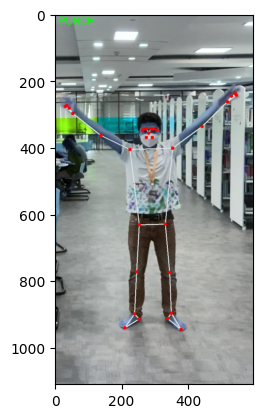

Start detect....
0 x: 0.47242435812950134
y: 0.3234272301197052
z: -0.4796637296676636
visibility: 0.9999021291732788

1 x: 0.4839232861995697
y: 0.3109186291694641
z: -0.4466838538646698
visibility: 0.9997896552085876

2 x: 0.4922446012496948
y: 0.3107411563396454
z: -0.44673648476600647
visibility: 0.999707818031311

3 x: 0.5003901124000549
y: 0.3106517791748047
z: -0.4468924403190613
visibility: 0.99973464012146

4 x: 0.4611979126930237
y: 0.31090688705444336
z: -0.4416739046573639
visibility: 0.9998092651367188

5 x: 0.45468783378601074
y: 0.31072381138801575
z: -0.44167834520339966
visibility: 0.9997161626815796

6 x: 0.44825446605682373
y: 0.3106270134449005
z: -0.4416365623474121
visibility: 0.9997736215591431

7 x: 0.5138781070709229
y: 0.31440532207489014
z: -0.23767796158790588
visibility: 0.9995918869972229

8 x: 0.43939173221588135
y: 0.3150132894515991
z: -0.2126215100288391
visibility: 0.9997457265853882

9 x: 0.49060308933258057
y: 0.33489564061164856
z: -0.3987200558185

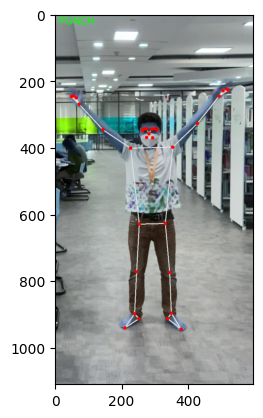

Start detect....
0 x: 0.4731816053390503
y: 0.32468903064727783
z: -0.48845773935317993
visibility: 0.9999060034751892

1 x: 0.48549872636795044
y: 0.3118516206741333
z: -0.4505850374698639
visibility: 0.9997931122779846

2 x: 0.4941565990447998
y: 0.3115682303905487
z: -0.45066511631011963
visibility: 0.9997144937515259

3 x: 0.502769947052002
y: 0.31133773922920227
z: -0.45075124502182007
visibility: 0.9997363686561584

4 x: 0.46274012327194214
y: 0.3117612600326538
z: -0.4510684311389923
visibility: 0.9998124837875366

5 x: 0.45640021562576294
y: 0.31141653656959534
z: -0.45108872652053833
visibility: 0.9997227191925049

6 x: 0.4502688944339752
y: 0.31112581491470337
z: -0.4510524570941925
visibility: 0.9997749328613281

7 x: 0.5178045630455017
y: 0.31450071930885315
z: -0.27129262685775757
visibility: 0.9995986819267273

8 x: 0.44311708211898804
y: 0.3151979446411133
z: -0.22161327302455902
visibility: 0.9997504353523254

9 x: 0.4916836619377136
y: 0.33512604236602783
z: -0.4002621

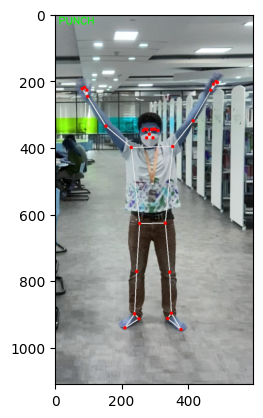

Start detect....
0 x: 0.4742426574230194
y: 0.3249102830886841
z: -0.6202353835105896
visibility: 0.999902606010437

1 x: 0.4855916202068329
y: 0.31206831336021423
z: -0.5855251550674438
visibility: 0.9997850060462952

2 x: 0.4941178858280182
y: 0.3117702603340149
z: -0.5854651927947998
visibility: 0.9997055530548096

3 x: 0.5027303099632263
y: 0.31152546405792236
z: -0.5855768322944641
visibility: 0.9997217059135437

4 x: 0.4641442596912384
y: 0.31194043159484863
z: -0.5830867290496826
visibility: 0.9998019337654114

5 x: 0.4583476483821869
y: 0.3114625811576843
z: -0.5831423401832581
visibility: 0.999711275100708

6 x: 0.45268720388412476
y: 0.31131234765052795
z: -0.5831437706947327
visibility: 0.999759316444397

7 x: 0.5181828737258911
y: 0.31453752517700195
z: -0.3758215010166168
visibility: 0.9995821118354797

8 x: 0.4442752003669739
y: 0.31529271602630615
z: -0.3553510308265686
visibility: 0.9997371435165405

9 x: 0.492151141166687
y: 0.33485016226768494
z: -0.5360401272773743
v

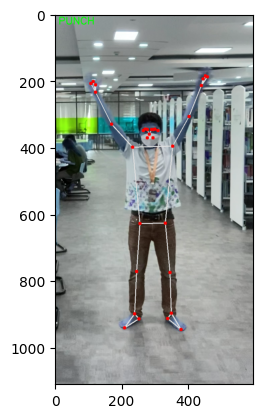

Start detect....
0 x: 0.47677719593048096
y: 0.32402363419532776
z: -0.5835264325141907
visibility: 0.9999032616615295

1 x: 0.48799052834510803
y: 0.3117908239364624
z: -0.5562812685966492
visibility: 0.9997884631156921

2 x: 0.4969292879104614
y: 0.3113596737384796
z: -0.5563052296638489
visibility: 0.9997080564498901

3 x: 0.5061706304550171
y: 0.31097689270973206
z: -0.5564447641372681
visibility: 0.9997243881225586

4 x: 0.46585631370544434
y: 0.31212514638900757
z: -0.5521049499511719
visibility: 0.9998045563697815

5 x: 0.4595833718776703
y: 0.31184086203575134
z: -0.5521329045295715
visibility: 0.999714732170105

6 x: 0.4534880816936493
y: 0.31177446246147156
z: -0.552091658115387
visibility: 0.9997621774673462

7 x: 0.5214646458625793
y: 0.31326666474342346
z: -0.3552185893058777
visibility: 0.9995731711387634

8 x: 0.4441288113594055
y: 0.3152007460594177
z: -0.3263406455516815
visibility: 0.9997381567955017

9 x: 0.4951286017894745
y: 0.3333234488964081
z: -0.500283777713775

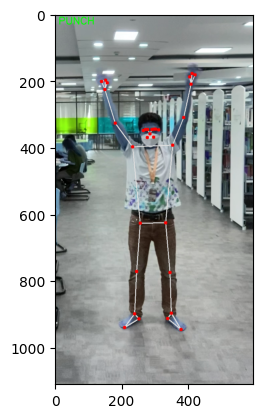

Start detect....
(1, 10, 132)0 x: 0.47848647832870483
y: 0.3230258524417877
z: -0.4807191789150238
visibility: 0.9998931884765625

1 x: 0.4890144467353821
y: 0.31165429949760437
z: -0.43863770365715027
visibility: 0.9997755885124207

2 x: 0.4976760149002075
y: 0.31130579113960266
z: -0.4385634958744049
visibility: 0.9996832013130188

3 x: 0.5068117380142212
y: 0.3109852969646454
z: -0.4386308491230011
visibility: 0.9997082352638245

4 x: 0.46764665842056274
y: 0.3120594322681427
z: -0.43129104375839233
visibility: 0.9997910857200623

5 x: 0.4612039625644684
y: 0.3119669556617737
z: -0.43132731318473816
visibility: 0.9996910095214844

6 x: 0.4550558030605316
y: 0.3120133876800537
z: -0.43132227659225464
visibility: 0.9997465014457703

7 x: 0.5214008688926697
y: 0.3132942020893097
z: -0.23941725492477417
visibility: 0.9995229840278625

8 x: 0.4442574381828308
y: 0.31530019640922546
z: -0.2032124549150467
visibility: 0.9997124075889587

9 x: 0.4959271252155304
y: 0.33173468708992004
z: -0

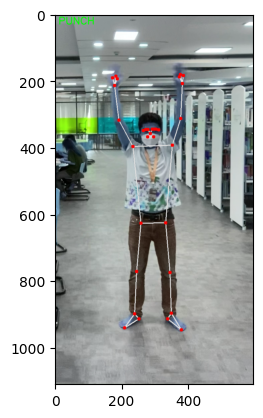

Start detect....
0 x: 0.4846656918525696
y: 0.3232273459434509
z: -0.43887484073638916
visibility: 0.9998902082443237

1 x: 0.4948776662349701
y: 0.3120638132095337
z: -0.39413732290267944
visibility: 0.9997758865356445

2 x: 0.5034220218658447
y: 0.31180351972579956
z: -0.39402833580970764
visibility: 0.9996804594993591

3 x: 0.5123005509376526
y: 0.3115552067756653
z: -0.39409974217414856
visibility: 0.9997093081474304

4 x: 0.4725322425365448
y: 0.3121388852596283
z: -0.3869237005710602
visibility: 0.9997879862785339

5 x: 0.4650816321372986
y: 0.3120020031929016
z: -0.3869706094264984
visibility: 0.9996842741966248

6 x: 0.45796751976013184
y: 0.3121081292629242
z: -0.38692596554756165
visibility: 0.9997425079345703

7 x: 0.5252442359924316
y: 0.31478622555732727
z: -0.18696510791778564
visibility: 0.9995238780975342

8 x: 0.44529861211776733
y: 0.3154248893260956
z: -0.15322242677211761
visibility: 0.9997090101242065

9 x: 0.5016946196556091
y: 0.33226868510246277
z: -0.3641600608

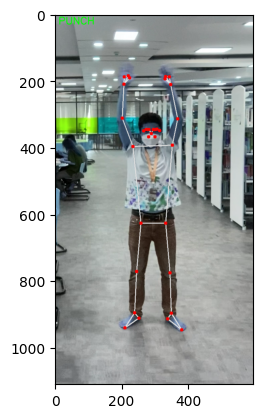

Start detect....
0 x: 0.48976364731788635
y: 0.32548391819000244
z: -0.42348185181617737
visibility: 0.9998446106910706

1 x: 0.5001413226127625
y: 0.31344887614250183
z: -0.37858274579048157
visibility: 0.9997139573097229

2 x: 0.5082298517227173
y: 0.3130118250846863
z: -0.37851276993751526
visibility: 0.9995880722999573

3 x: 0.516482412815094
y: 0.31262898445129395
z: -0.3786212205886841
visibility: 0.9996432662010193

4 x: 0.47609588503837585
y: 0.31372135877609253
z: -0.3690289855003357
visibility: 0.9997156858444214

5 x: 0.4673123359680176
y: 0.31347161531448364
z: -0.36906394362449646
visibility: 0.999563992023468

6 x: 0.4589932858943939
y: 0.3134095072746277
z: -0.36907878518104553
visibility: 0.9996517300605774

7 x: 0.5268717408180237
y: 0.3158320486545563
z: -0.16911329329013824
visibility: 0.9994130730628967

8 x: 0.44559016823768616
y: 0.3168448209762573
z: -0.12250173091888428
visibility: 0.999615490436554

9 x: 0.5060418844223022
y: 0.33429908752441406
z: -0.346954464

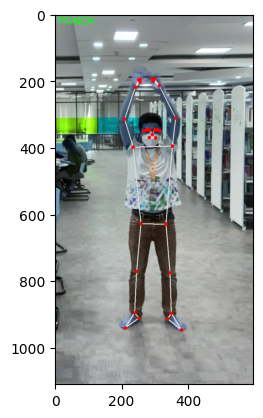

Start detect....
0 x: 0.4897991418838501
y: 0.3250226676464081
z: -0.4479731619358063
visibility: 0.9996415972709656

1 x: 0.5008811950683594
y: 0.3128880262374878
z: -0.4068472385406494
visibility: 0.9994289875030518

2 x: 0.5090181827545166
y: 0.31253671646118164
z: -0.40678882598876953
visibility: 0.9991562962532043

3 x: 0.5170964598655701
y: 0.3122353255748749
z: -0.40689706802368164
visibility: 0.9993101358413696

4 x: 0.476003497838974
y: 0.3129763901233673
z: -0.39968007802963257
visibility: 0.9994131922721863

5 x: 0.467043936252594
y: 0.3127078413963318
z: -0.3997097909450531
visibility: 0.9990955591201782

6 x: 0.45890742540359497
y: 0.3125731647014618
z: -0.39968639612197876
visibility: 0.9993188381195068

7 x: 0.5274689197540283
y: 0.3158344328403473
z: -0.1973780244588852
visibility: 0.9987949132919312

8 x: 0.44560784101486206
y: 0.31655535101890564
z: -0.1635507345199585
visibility: 0.9992386102676392

9 x: 0.506392776966095
y: 0.3339841365814209
z: -0.37016409635543823

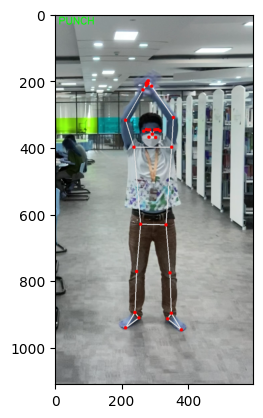

Start detect....
0 x: 0.4894906282424927
y: 0.3250543177127838
z: -0.40047070384025574
visibility: 0.9995231032371521

1 x: 0.5004919171333313
y: 0.31285202503204346
z: -0.3615604639053345
visibility: 0.9992519021034241

2 x: 0.5085995197296143
y: 0.3124842047691345
z: -0.3614576458930969
visibility: 0.9988895654678345

3 x: 0.5166217684745789
y: 0.3121664822101593
z: -0.3614915609359741
visibility: 0.9991034865379333

4 x: 0.4757193326950073
y: 0.3129734694957733
z: -0.3602527678012848
visibility: 0.9992275834083557

5 x: 0.4668457806110382
y: 0.3126843571662903
z: -0.3603023588657379
visibility: 0.998820424079895

6 x: 0.45881175994873047
y: 0.3124772310256958
z: -0.36041051149368286
visibility: 0.9991322159767151

7 x: 0.5272049903869629
y: 0.31584569811820984
z: -0.15471191704273224
visibility: 0.998511016368866

8 x: 0.4455893635749817
y: 0.31616130471229553
z: -0.14360086619853973
visibility: 0.9990845918655396

9 x: 0.5061076283454895
y: 0.33446839451789856
z: -0.321795582771301

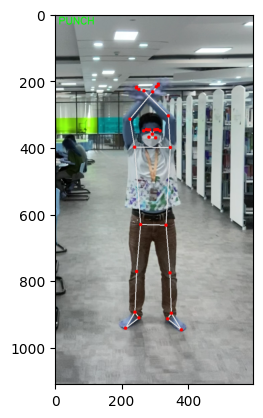

Start detect....
0 x: 0.4892160892486572
y: 0.324556827545166
z: -0.38545405864715576
visibility: 0.9994838833808899

1 x: 0.5001186728477478
y: 0.31221485137939453
z: -0.3460525870323181
visibility: 0.9991993308067322

2 x: 0.5082894563674927
y: 0.3118259310722351
z: -0.34589776396751404
visibility: 0.9988108277320862

3 x: 0.5164991021156311
y: 0.31144610047340393
z: -0.34587687253952026
visibility: 0.9990453720092773

4 x: 0.4754940867424011
y: 0.31213003396987915
z: -0.34904325008392334
visibility: 0.9991787075996399

5 x: 0.4666769504547119
y: 0.31164976954460144
z: -0.34911277890205383
visibility: 0.9987578392028809

6 x: 0.4586857557296753
y: 0.3111862242221832
z: -0.34924986958503723
visibility: 0.9990975260734558

7 x: 0.525964081287384
y: 0.31562894582748413
z: -0.1345423310995102
visibility: 0.9984691143035889

8 x: 0.4454777240753174
y: 0.3150256872177124
z: -0.14318300783634186
visibility: 0.999083399772644

9 x: 0.5058512091636658
y: 0.33438780903816223
z: -0.304825335741

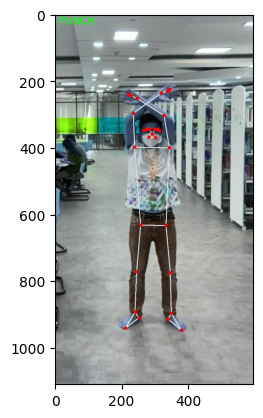

Start detect....
0 x: 0.4838937819004059
y: 0.3191981315612793
z: -0.41104018688201904
visibility: 0.999501645565033

1 x: 0.49564361572265625
y: 0.3077661693096161
z: -0.37195485830307007
visibility: 0.9992349743843079

2 x: 0.503652811050415
y: 0.3072468042373657
z: -0.37184807658195496
visibility: 0.9988691806793213

3 x: 0.5116375088691711
y: 0.30662238597869873
z: -0.3718591630458832
visibility: 0.9990902543067932

4 x: 0.4708409011363983
y: 0.30831485986709595
z: -0.3721890151500702
visibility: 0.9992127418518066

5 x: 0.462379515171051
y: 0.3082324266433716
z: -0.3722440302371979
visibility: 0.9988141059875488

6 x: 0.4545004367828369
y: 0.308027058839798
z: -0.3723307251930237
visibility: 0.99913090467453

7 x: 0.5195772647857666
y: 0.3120097815990448
z: -0.15870462357997894
visibility: 0.9985638856887817

8 x: 0.44245845079421997
y: 0.3136656880378723
z: -0.15360964834690094
visibility: 0.99913090467453

9 x: 0.5002576112747192
y: 0.32847949862480164
z: -0.3297937214374542
vis

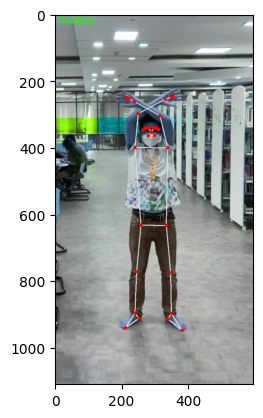

Start detect....
0 x: 0.48388516902923584
y: 0.3195999264717102
z: -0.43654075264930725
visibility: 0.9995380640029907

1 x: 0.4956319332122803
y: 0.30782777070999146
z: -0.39832526445388794
visibility: 0.9992933869361877

2 x: 0.5036454200744629
y: 0.3073245882987976
z: -0.3981872797012329
visibility: 0.9989578127861023

3 x: 0.5116440653800964
y: 0.30674442648887634
z: -0.39809757471084595
visibility: 0.9991608262062073

4 x: 0.47071003913879395
y: 0.30860430002212524
z: -0.40317609906196594
visibility: 0.9992712736129761

5 x: 0.46201103925704956
y: 0.30867910385131836
z: -0.40322449803352356
visibility: 0.9989036917686462

6 x: 0.45366939902305603
y: 0.3085832893848419
z: -0.40326669812202454
visibility: 0.9991936683654785

7 x: 0.5196008086204529
y: 0.31326669454574585
z: -0.17427989840507507
visibility: 0.99868243932724

8 x: 0.44048693776130676
y: 0.3147766888141632
z: -0.19218790531158447
visibility: 0.9991968870162964

9 x: 0.500275194644928
y: 0.32863929867744446
z: -0.350229

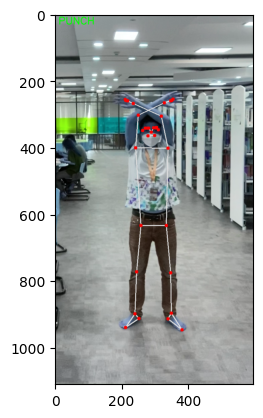

Start detect....
0 x: 0.4842880070209503
y: 0.31994038820266724
z: -0.4359275698661804
visibility: 0.9995677471160889

1 x: 0.49614694714546204
y: 0.30868691205978394
z: -0.3952062129974365
visibility: 0.9993438124656677

2 x: 0.5041934251785278
y: 0.3085249662399292
z: -0.3951120376586914
visibility: 0.999035120010376

3 x: 0.5122025012969971
y: 0.3082902133464813
z: -0.3950408697128296
visibility: 0.9992215037345886

4 x: 0.47073641419410706
y: 0.3087100386619568
z: -0.4003872573375702
visibility: 0.9993195533752441

5 x: 0.4619660973548889
y: 0.30892613530158997
z: -0.40039822459220886
visibility: 0.9989790320396423

6 x: 0.4533657729625702
y: 0.3088811933994293
z: -0.40041497349739075
visibility: 0.9992436170578003

7 x: 0.5196236968040466
y: 0.31427422165870667
z: -0.16934892535209656
visibility: 0.9987876415252686

8 x: 0.4400060772895813
y: 0.31480032205581665
z: -0.18933187425136566
visibility: 0.999252438545227

9 x: 0.5003184080123901
y: 0.32970818877220154
z: -0.350374966859

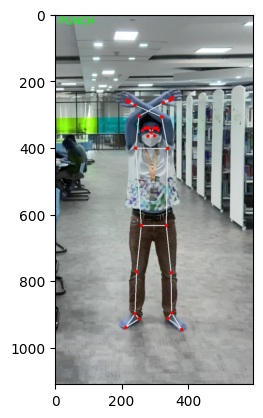

Start detect....
0 x: 0.4884658455848694
y: 0.32021161913871765
z: -0.43752622604370117
visibility: 0.9995792508125305

1 x: 0.4993232786655426
y: 0.30876272916793823
z: -0.39661869406700134
visibility: 0.9993690848350525

2 x: 0.5068319439888
y: 0.30863723158836365
z: -0.39652231335639954
visibility: 0.9990738034248352

3 x: 0.5143128633499146
y: 0.3083855211734772
z: -0.39646926522254944
visibility: 0.9992512464523315

4 x: 0.47539228200912476
y: 0.30896666646003723
z: -0.4011783301830292
visibility: 0.9993429780006409

5 x: 0.4667222201824188
y: 0.30915045738220215
z: -0.4011950194835663
visibility: 0.9990174770355225

6 x: 0.45820462703704834
y: 0.30900415778160095
z: -0.4012163579463959
visibility: 0.9992694854736328

7 x: 0.5206430554389954
y: 0.3142789900302887
z: -0.16881664097309113
visibility: 0.9988543391227722

8 x: 0.44546207785606384
y: 0.31416597962379456
z: -0.19085222482681274
visibility: 0.99929279088974

9 x: 0.5028694272041321
y: 0.33009129762649536
z: -0.3518406152

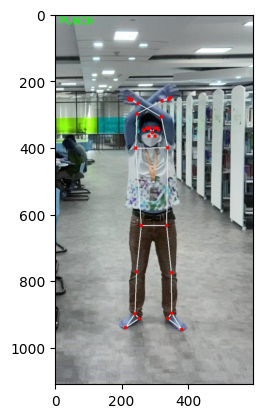

Start detect....
(1, 10, 132)
0 x: 0.4898969531059265
y: 0.3233341872692108
z: -0.36657315492630005
visibility: 0.9994928240776062

1 x: 0.49988463521003723
y: 0.3115014135837555
z: -0.32878339290618896
visibility: 0.9992457628250122

2 x: 0.5071732997894287
y: 0.3112294375896454
z: -0.3287407159805298
visibility: 0.9989019632339478

3 x: 0.5144590139389038
y: 0.31087470054626465
z: -0.32876303791999817
visibility: 0.9991354942321777

4 x: 0.4768027067184448
y: 0.3119775354862213
z: -0.32732510566711426
visibility: 0.9991791844367981

5 x: 0.4682261347770691
y: 0.3120880424976349
z: -0.32729700207710266
visibility: 0.9987500905990601

6 x: 0.45969313383102417
y: 0.3119535744190216
z: -0.3273095488548279
visibility: 0.9990935325622559

7 x: 0.520831823348999
y: 0.3149568736553192
z: -0.12659141421318054
visibility: 0.9987503886222839

8 x: 0.4467198848724365
y: 0.31474971771240234
z: -0.11442132294178009
visibility: 0.9991608262062073

9 x: 0.5040362477302551
y: 0.3321589529514313
z: -0

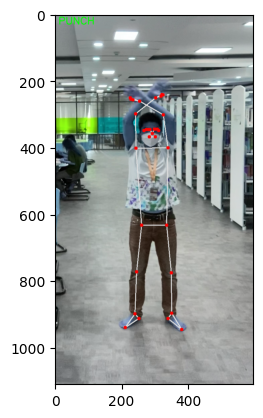

Start detect....
0 x: 0.48974180221557617
y: 0.32675936818122864
z: -0.3195655643939972
visibility: 0.9994709491729736

1 x: 0.4998563826084137
y: 0.3150078058242798
z: -0.2832774817943573
visibility: 0.99920254945755

2 x: 0.5071225166320801
y: 0.31481948494911194
z: -0.28320956230163574
visibility: 0.9988251328468323

3 x: 0.5143249034881592
y: 0.3145619332790375
z: -0.2832992672920227
visibility: 0.9990905523300171

4 x: 0.47669026255607605
y: 0.3156392276287079
z: -0.2788625955581665
visibility: 0.9991304278373718

5 x: 0.46805864572525024
y: 0.3158015012741089
z: -0.27890005707740784
visibility: 0.9986621737480164

6 x: 0.45955780148506165
y: 0.31574520468711853
z: -0.27891960740089417
visibility: 0.9990450143814087

7 x: 0.5208273530006409
y: 0.31747373938560486
z: -0.09419997781515121
visibility: 0.9986987709999084

8 x: 0.4467410445213318
y: 0.3169664144515991
z: -0.0690392479300499
visibility: 0.9991297125816345

9 x: 0.5039896965026855
y: 0.33498820662498474
z: -0.24793635308

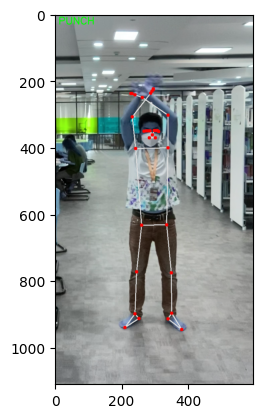

Start detect....
0 x: 0.48930948972702026
y: 0.3279750347137451
z: -0.31217512488365173
visibility: 0.9994801878929138

1 x: 0.4995947778224945
y: 0.3162382245063782
z: -0.2744712829589844
visibility: 0.9992147088050842

2 x: 0.5069806575775146
y: 0.316018283367157
z: -0.27441924810409546
visibility: 0.9988317489624023

3 x: 0.5142773985862732
y: 0.3157126307487488
z: -0.2745291590690613
visibility: 0.9991065859794617

4 x: 0.47599872946739197
y: 0.3169482946395874
z: -0.26718899607658386
visibility: 0.9991452693939209

5 x: 0.46736565232276917
y: 0.31715282797813416
z: -0.2672203481197357
visibility: 0.9986729025840759

6 x: 0.45895159244537354
y: 0.3171256184577942
z: -0.267261803150177
visibility: 0.9990600943565369

7 x: 0.5208360552787781
y: 0.317836195230484
z: -0.09101717174053192
visibility: 0.9987051486968994

8 x: 0.4466668367385864
y: 0.31744346022605896
z: -0.053938694298267365
visibility: 0.9991381764411926

9 x: 0.5037357211112976
y: 0.33594733476638794
z: -0.243868887424

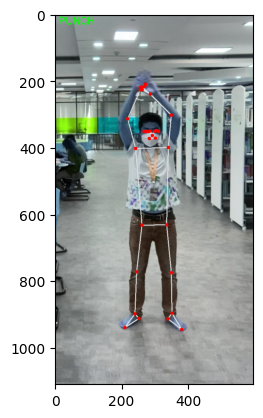

Start detect....
0 x: 0.48927751183509827
y: 0.32765427231788635
z: -0.32557886838912964
visibility: 0.9995036125183105

1 x: 0.49951258301734924
y: 0.316160649061203
z: -0.28391367197036743
visibility: 0.9992454648017883

2 x: 0.506928563117981
y: 0.31598538160324097
z: -0.2838526964187622
visibility: 0.9988728165626526

3 x: 0.5143793821334839
y: 0.3156527876853943
z: -0.2839236259460449
visibility: 0.9991407990455627

4 x: 0.475872278213501
y: 0.31691163778305054
z: -0.27611878514289856
visibility: 0.999180257320404

5 x: 0.4673158824443817
y: 0.3170061707496643
z: -0.2761562168598175
visibility: 0.9987232685089111

6 x: 0.45909789204597473
y: 0.31692010164260864
z: -0.276193767786026
visibility: 0.9990959167480469

7 x: 0.5217477083206177
y: 0.3178061842918396
z: -0.09472525864839554
visibility: 0.998742938041687

8 x: 0.44683289527893066
y: 0.31742674112319946
z: -0.05531492084264755
visibility: 0.9991635680198669

9 x: 0.5035561919212341
y: 0.33575549721717834
z: -0.2566002309322

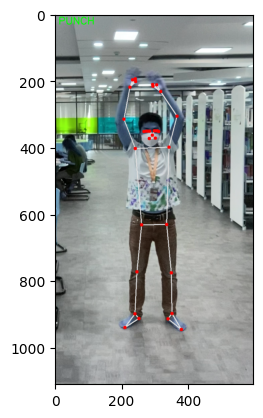

Start detect....
0 x: 0.4898626208305359
y: 0.3283250629901886
z: -0.347061425447464
visibility: 0.9995416402816772

1 x: 0.500277042388916
y: 0.3171699345111847
z: -0.30726632475852966
visibility: 0.9993005990982056

2 x: 0.5079090595245361
y: 0.31703993678092957
z: -0.3072010278701782
visibility: 0.9989521503448486

3 x: 0.5156056880950928
y: 0.3167675733566284
z: -0.3072586953639984
visibility: 0.999199390411377

4 x: 0.47683125734329224
y: 0.31751567125320435
z: -0.3023166358470917
visibility: 0.9992425441741943

5 x: 0.4684664309024811
y: 0.31754636764526367
z: -0.30234748125076294
visibility: 0.9988195896148682

6 x: 0.46035316586494446
y: 0.3174689710140228
z: -0.3023766875267029
visibility: 0.9991636872291565

7 x: 0.5234037637710571
y: 0.318683385848999
z: -0.10355564951896667
visibility: 0.9988211393356323

8 x: 0.4471420645713806
y: 0.3176875114440918
z: -0.0782691165804863
visibility: 0.9992237091064453

9 x: 0.5043254494667053
y: 0.33696886897087097
z: -0.2749543786048889


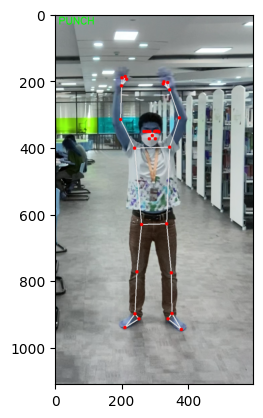

Start detect....
0 x: 0.489532470703125
y: 0.32480189204216003
z: -0.4043247699737549
visibility: 0.9995817542076111

1 x: 0.49999743700027466
y: 0.31483983993530273
z: -0.3589525818824768
visibility: 0.9993605017662048

2 x: 0.5078262090682983
y: 0.3147274851799011
z: -0.35886529088020325
visibility: 0.9990401864051819

3 x: 0.5155612230300903
y: 0.31456074118614197
z: -0.35893547534942627
visibility: 0.9992659091949463

4 x: 0.476754367351532
y: 0.31584298610687256
z: -0.3467486798763275
visibility: 0.9993097186088562

5 x: 0.46845272183418274
y: 0.31630897521972656
z: -0.34681788086891174
visibility: 0.9989239573478699

6 x: 0.460758239030838
y: 0.3166317641735077
z: -0.34679946303367615
visibility: 0.9992378950119019

7 x: 0.524562418460846
y: 0.31781116127967834
z: -0.1654166877269745
visibility: 0.9989074468612671

8 x: 0.44787824153900146
y: 0.31749090552330017
z: -0.1086515262722969
visibility: 0.9992885589599609

9 x: 0.5042998194694519
y: 0.3334292471408844
z: -0.338641762733

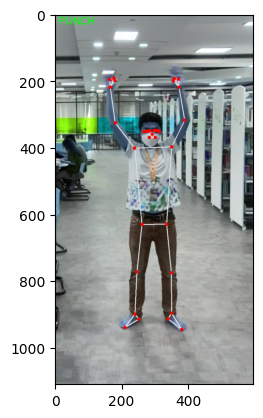

Start detect....
0 x: 0.48945552110671997
y: 0.32478246092796326
z: -0.4825934171676636
visibility: 0.9996150135993958

1 x: 0.4999415874481201
y: 0.3144140839576721
z: -0.43659496307373047
visibility: 0.9994088411331177

2 x: 0.5077715516090393
y: 0.3141826391220093
z: -0.436551958322525
visibility: 0.9991112947463989

3 x: 0.5155827403068542
y: 0.31393465399742126
z: -0.4366655945777893
visibility: 0.9993174076080322

4 x: 0.47668686509132385
y: 0.31566423177719116
z: -0.4316350519657135
visibility: 0.9993647933006287

5 x: 0.4686470925807953
y: 0.31621792912483215
z: -0.43168461322784424
visibility: 0.9990102648735046

6 x: 0.46148088574409485
y: 0.31660208106040955
z: -0.43167170882225037
visibility: 0.9992979764938354

7 x: 0.5253435373306274
y: 0.31707409024238586
z: -0.21985933184623718
visibility: 0.9989653825759888

8 x: 0.4501109719276428
y: 0.31733670830726624
z: -0.19819296896457672
visibility: 0.9993382692337036

9 x: 0.5051226019859314
y: 0.333458811044693
z: -0.405060559

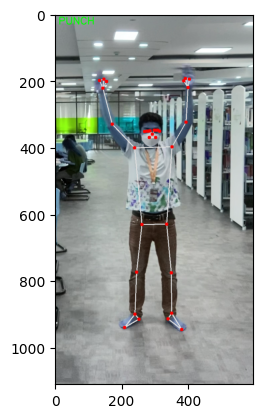

Start detect....
0 x: 0.4830661118030548
y: 0.32453930377960205
z: -0.4975149631500244
visibility: 0.9996506571769714

1 x: 0.4939078092575073
y: 0.31332093477249146
z: -0.45967310667037964
visibility: 0.9994616508483887

2 x: 0.5023486614227295
y: 0.3128295838832855
z: -0.45957455039024353
visibility: 0.9991912841796875

3 x: 0.5108586549758911
y: 0.3123905658721924
z: -0.4596610367298126
visibility: 0.9993767738342285

4 x: 0.4707200825214386
y: 0.3152754604816437
z: -0.449761301279068
visibility: 0.9994227290153503

5 x: 0.4633707106113434
y: 0.3160386383533478
z: -0.44981178641319275
visibility: 0.9991013407707214

6 x: 0.45666104555130005
y: 0.31657707691192627
z: -0.44976016879081726
visibility: 0.9993612766265869

7 x: 0.5233697891235352
y: 0.3158753514289856
z: -0.26495081186294556
visibility: 0.9990509748458862

8 x: 0.44876453280448914
y: 0.3173457980155945
z: -0.2210347205400467
visibility: 0.9993960857391357

9 x: 0.5014417767524719
y: 0.3333202600479126
z: -0.4264549016952

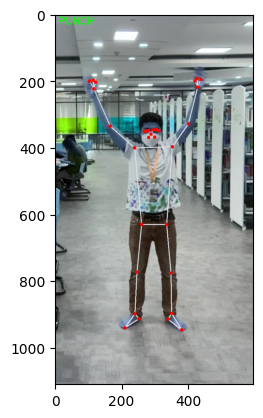

Start detect....
0 x: 0.4814894497394562
y: 0.3252008855342865
z: -0.6280871629714966
visibility: 0.9996817708015442

1 x: 0.4924637973308563
y: 0.3134217858314514
z: -0.5952073931694031
visibility: 0.9995059967041016

2 x: 0.5010982155799866
y: 0.31296226382255554
z: -0.5950713157653809
visibility: 0.9992605447769165

3 x: 0.5098304152488708
y: 0.3126056492328644
z: -0.5951673984527588
visibility: 0.9994261860847473

4 x: 0.46899715065956116
y: 0.3153868615627289
z: -0.5880215764045715
visibility: 0.9994720816612244

5 x: 0.46185317635536194
y: 0.316154420375824
z: -0.5880886316299438
visibility: 0.9991805553436279

6 x: 0.45521116256713867
y: 0.3167208731174469
z: -0.588014543056488
visibility: 0.9994140863418579

7 x: 0.5230096578598022
y: 0.3165011703968048
z: -0.3874623477458954
visibility: 0.99912428855896

8 x: 0.44849497079849243
y: 0.31767189502716064
z: -0.35651254653930664
visibility: 0.9994433522224426

9 x: 0.5006072521209717
y: 0.3345559239387512
z: -0.5485597252845764
vi

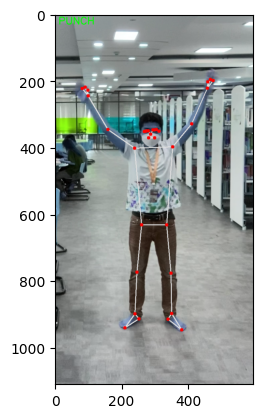

Start detect....
0 x: 0.4770452380180359
y: 0.3250812292098999
z: -0.6035804152488708
visibility: 0.9997105002403259

1 x: 0.488608181476593
y: 0.3128172755241394
z: -0.5739837884902954
visibility: 0.9995461106300354

2 x: 0.49736109375953674
y: 0.3123096823692322
z: -0.5738956332206726
visibility: 0.9993231892585754

3 x: 0.5062838792800903
y: 0.3119310438632965
z: -0.5740190744400024
visibility: 0.9994703531265259

4 x: 0.4660848379135132
y: 0.3150337040424347
z: -0.563188374042511
visibility: 0.9995176792144775

5 x: 0.45956048369407654
y: 0.31590980291366577
z: -0.5632696747779846
visibility: 0.9992538094520569

6 x: 0.4533543288707733
y: 0.31657230854034424
z: -0.563205361366272
visibility: 0.9994637370109558

7 x: 0.5215575695037842
y: 0.31588634848594666
z: -0.3713971972465515
visibility: 0.9991925954818726

8 x: 0.4481264650821686
y: 0.31763628125190735
z: -0.32472488284111023
visibility: 0.9994886517524719

9 x: 0.4966055452823639
y: 0.3345412611961365
z: -0.5253483057022095
v

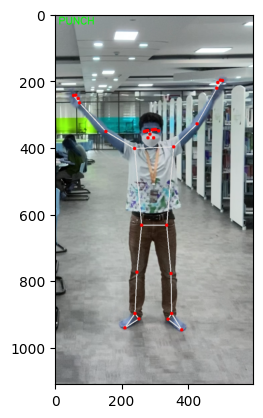

Start detect....
(1, 10, 132)0 x: 0.4745161831378937
y: 0.3252203166484833
z: -0.5522109270095825
visibility: 0.9997371435165405

1 x: 0.48619306087493896
y: 0.31281766295433044
z: -0.5196360349655151
visibility: 0.9995840191841125

2 x: 0.4948684275150299
y: 0.3123081922531128
z: -0.5195648670196533
visibility: 0.9993817210197449

3 x: 0.5037825107574463
y: 0.31192487478256226
z: -0.519672691822052
visibility: 0.9995121359825134

4 x: 0.4642130732536316
y: 0.31503018736839294
z: -0.5110486149787903
visibility: 0.9995606541633606

5 x: 0.45794957876205444
y: 0.31589365005493164
z: -0.5111154913902283
visibility: 0.9993224143981934

6 x: 0.4519188404083252
y: 0.3165566027164459
z: -0.511063814163208
visibility: 0.999511182308197

7 x: 0.5201429128646851
y: 0.31579577922821045
z: -0.31758031249046326
visibility: 0.9992574453353882

8 x: 0.44727423787117004
y: 0.3178553581237793
z: -0.2800757586956024
visibility: 0.99953293800354

9 x: 0.4936017394065857
y: 0.3347649872303009
z: -0.475108

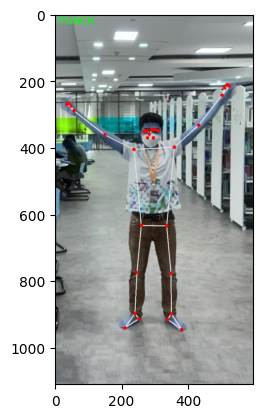

Start detect....
0 x: 0.47463661432266235
y: 0.3252134919166565
z: -0.5487253069877625
visibility: 0.9997620582580566

1 x: 0.48635971546173096
y: 0.31280478835105896
z: -0.5055245757102966
visibility: 0.9996211528778076

2 x: 0.49503082036972046
y: 0.3122987449169159
z: -0.5054468512535095
visibility: 0.999437689781189

3 x: 0.5039421319961548
y: 0.3119173049926758
z: -0.5055558085441589
visibility: 0.999553918838501

4 x: 0.46433964371681213
y: 0.31502291560173035
z: -0.4956040382385254
visibility: 0.9996017813682556

5 x: 0.45804211497306824
y: 0.31586357951164246
z: -0.4956710636615753
visibility: 0.9993869066238403

6 x: 0.4519660472869873
y: 0.3165135979652405
z: -0.49567434191703796
visibility: 0.9995567798614502

7 x: 0.5201669931411743
y: 0.3157344162464142
z: -0.30410847067832947
visibility: 0.9993223547935486

8 x: 0.44720572233200073
y: 0.31807228922843933
z: -0.2626822292804718
visibility: 0.9995763301849365

9 x: 0.4935920834541321
y: 0.3347669839859009
z: -0.465372532606

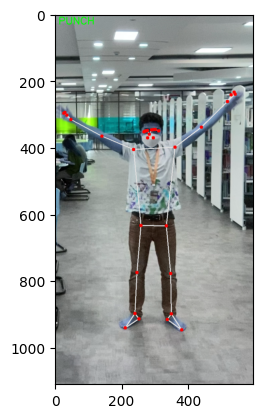

Start detect....
0 x: 0.4752918779850006
y: 0.32514819502830505
z: -0.47287777066230774
visibility: 0.9997842907905579

1 x: 0.4877796173095703
y: 0.3128049075603485
z: -0.44141650199890137
visibility: 0.9996534585952759

2 x: 0.49638959765434265
y: 0.3123073875904083
z: -0.44134870171546936
visibility: 0.9994869828224182

3 x: 0.5050686597824097
y: 0.3119436204433441
z: -0.4414461851119995
visibility: 0.9995906352996826

4 x: 0.4651353657245636
y: 0.3150123059749603
z: -0.43883541226387024
visibility: 0.9996380805969238

5 x: 0.4585738182067871
y: 0.31584644317626953
z: -0.4388743042945862
visibility: 0.999444305896759

6 x: 0.45229098200798035
y: 0.31648483872413635
z: -0.43877390027046204
visibility: 0.9995970726013184

7 x: 0.5206354856491089
y: 0.3157442510128021
z: -0.2419683188199997
visibility: 0.9993792772293091

8 x: 0.4472406506538391
y: 0.31807541847229004
z: -0.23706571757793427
visibility: 0.9996143579483032

9 x: 0.494073748588562
y: 0.3347705602645874
z: -0.394632160663

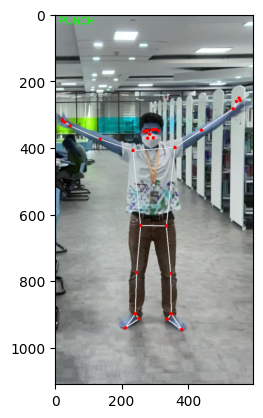

Start detect....
0 x: 0.4796169102191925
y: 0.3255007863044739
z: -0.5362659692764282
visibility: 0.9998046159744263

1 x: 0.4926121234893799
y: 0.3137468099594116
z: -0.504876434803009
visibility: 0.9996829628944397

2 x: 0.5012885332107544
y: 0.31349921226501465
z: -0.5048195123672485
visibility: 0.9995321035385132

3 x: 0.5092987418174744
y: 0.31332722306251526
z: -0.5049188733100891
visibility: 0.9996243119239807

4 x: 0.46885886788368225
y: 0.3152366578578949
z: -0.504299521446228
visibility: 0.9996709823608398

5 x: 0.46139654517173767
y: 0.31593742966651917
z: -0.5043604373931885
visibility: 0.9994962811470032

6 x: 0.4543501138687134
y: 0.31651046872138977
z: -0.5042769312858582
visibility: 0.9996333718299866

7 x: 0.5239522457122803
y: 0.3167380392551422
z: -0.2849833369255066
visibility: 0.9994326829910278

8 x: 0.44743990898132324
y: 0.31822720170021057
z: -0.28882476687431335
visibility: 0.9996489882469177

9 x: 0.49805471301078796
y: 0.3355827331542969
z: -0.45070028305053

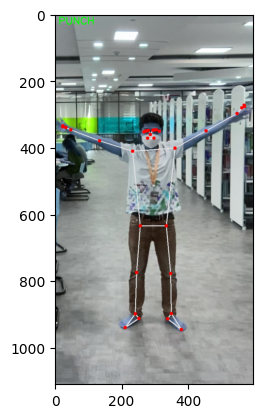

Start detect....
0 x: 0.4804529845714569
y: 0.32597190141677856
z: -0.5327504277229309
visibility: 0.9998220801353455

1 x: 0.4934304654598236
y: 0.31410592794418335
z: -0.5036993026733398
visibility: 0.999704122543335

2 x: 0.5020714998245239
y: 0.31390616297721863
z: -0.5035298466682434
visibility: 0.9995670914649963

3 x: 0.5101298689842224
y: 0.31377679109573364
z: -0.5036379098892212
visibility: 0.9996477365493774

4 x: 0.4702143967151642
y: 0.31532227993011475
z: -0.49407288432121277
visibility: 0.9996967911720276

5 x: 0.4630137085914612
y: 0.3159520924091339
z: -0.49416714906692505
visibility: 0.9995390772819519

6 x: 0.45627495646476746
y: 0.3164978325366974
z: -0.4941120445728302
visibility: 0.9996615052223206

7 x: 0.5246949195861816
y: 0.3172415494918823
z: -0.27304086089134216
visibility: 0.9994704723358154

8 x: 0.44883543252944946
y: 0.31845661997795105
z: -0.2733393609523773
visibility: 0.9996751546859741

9 x: 0.49850648641586304
y: 0.3363220691680908
z: -0.44720807671

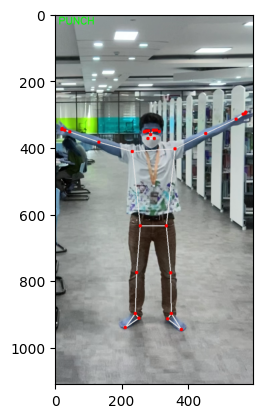

Start detect....
0 x: 0.48324862122535706
y: 0.32642537355422974
z: -0.49151918292045593
visibility: 0.9998372197151184

1 x: 0.4952474534511566
y: 0.31443876028060913
z: -0.4577852785587311
visibility: 0.9997202754020691

2 x: 0.5036308765411377
y: 0.3142474889755249
z: -0.45773544907569885
visibility: 0.9995954036712646

3 x: 0.5114346742630005
y: 0.3141130805015564
z: -0.45781880617141724
visibility: 0.9996653199195862

4 x: 0.4724726974964142
y: 0.31554704904556274
z: -0.45930394530296326
visibility: 0.9997180104255676

5 x: 0.46531984210014343
y: 0.3161102831363678
z: -0.4593118131160736
visibility: 0.9995753765106201

6 x: 0.45859789848327637
y: 0.31662362813949585
z: -0.45922017097473145
visibility: 0.9996843338012695

7 x: 0.5251717567443848
y: 0.3177797198295593
z: -0.24027274549007416
visibility: 0.9995005130767822

8 x: 0.4497247338294983
y: 0.31910619139671326
z: -0.26343074440956116
visibility: 0.9996954798698425

9 x: 0.5003492832183838
y: 0.33711183071136475
z: -0.409845

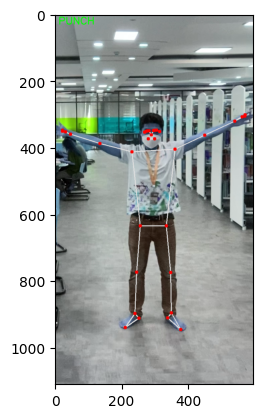

Start detect....
0 x: 0.48426175117492676
y: 0.3263828456401825
z: -0.5102503895759583
visibility: 0.9998515844345093

1 x: 0.4964412748813629
y: 0.31437498331069946
z: -0.4736899435520172
visibility: 0.9997371435165405

2 x: 0.504761815071106
y: 0.3142319917678833
z: -0.4736967086791992
visibility: 0.9996239542961121

3 x: 0.5125688314437866
y: 0.31410348415374756
z: -0.47378191351890564
visibility: 0.9996843934059143

4 x: 0.4739304184913635
y: 0.31516292691230774
z: -0.47530287504196167
visibility: 0.9997383952140808

5 x: 0.4668568968772888
y: 0.31557101011276245
z: -0.47531792521476746
visibility: 0.9996093511581421

6 x: 0.46011701226234436
y: 0.3159414231777191
z: -0.47525322437286377
visibility: 0.9997058510780334

7 x: 0.5258913636207581
y: 0.31802457571029663
z: -0.2498742640018463
visibility: 0.9995335936546326

8 x: 0.4500560760498047
y: 0.31900036334991455
z: -0.2653515040874481
visibility: 0.9997153878211975

9 x: 0.5007392764091492
y: 0.3371668756008148
z: -0.42677035927

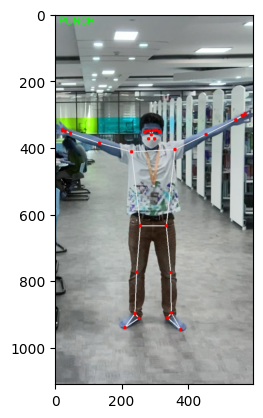

Start detect....
0 x: 0.4847152531147003
y: 0.326821506023407
z: -0.5899102687835693
visibility: 0.9998652338981628

1 x: 0.4972347915172577
y: 0.3146410584449768
z: -0.5574575066566467
visibility: 0.9997576475143433

2 x: 0.505620002746582
y: 0.3145486116409302
z: -0.5574160218238831
visibility: 0.99965500831604

3 x: 0.5132983922958374
y: 0.3144955337047577
z: -0.5575032830238342
visibility: 0.9997079372406006

4 x: 0.47424188256263733
y: 0.31523966789245605
z: -0.5587313771247864
visibility: 0.9997608065605164

5 x: 0.46695664525032043
y: 0.31559881567955017
z: -0.5587975978851318
visibility: 0.99964439868927

6 x: 0.46012797951698303
y: 0.3159492015838623
z: -0.5587440133094788
visibility: 0.9997304677963257

7 x: 0.5265265107154846
y: 0.31839877367019653
z: -0.33586329221725464
visibility: 0.9995718002319336

8 x: 0.45004063844680786
y: 0.3190356194972992
z: -0.34633442759513855
visibility: 0.9997393488883972

9 x: 0.5011184811592102
y: 0.33823448419570923
z: -0.5046936273574829
v

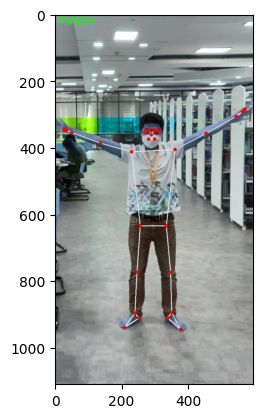

Start detect....
0 x: 0.486067533493042
y: 0.32564929127693176
z: -0.5141401290893555
visibility: 0.9998769164085388

1 x: 0.4976758360862732
y: 0.3137437701225281
z: -0.4759328365325928
visibility: 0.9997738599777222

2 x: 0.5058712363243103
y: 0.3137874901294708
z: -0.4759630560874939
visibility: 0.9996800422668457

3 x: 0.5133873224258423
y: 0.3138817250728607
z: -0.4760638177394867
visibility: 0.9997261166572571

4 x: 0.47490230202674866
y: 0.31398263573646545
z: -0.48101985454559326
visibility: 0.999779462814331

5 x: 0.4674564301967621
y: 0.3141998052597046
z: -0.48101285099983215
visibility: 0.9996740818023682

6 x: 0.4604909420013428
y: 0.3144862651824951
z: -0.480942040681839
visibility: 0.9997508525848389

7 x: 0.5263352990150452
y: 0.3182036280632019
z: -0.2572692632675171
visibility: 0.999600887298584

8 x: 0.4499828815460205
y: 0.3187182545661926
z: -0.2837056815624237
visibility: 0.9997586011886597

9 x: 0.5017738342285156
y: 0.33785608410835266
z: -0.43195855617523193
vi

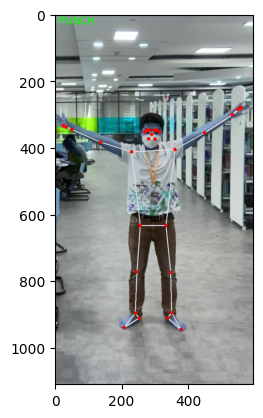

Start detect....
0 x: 0.4871375560760498
y: 0.3254796862602234
z: -0.4964387118816376
visibility: 0.999888002872467

1 x: 0.4983328580856323
y: 0.31353315711021423
z: -0.4599321186542511
visibility: 0.9997918605804443

2 x: 0.5064234733581543
y: 0.31361061334609985
z: -0.45994803309440613
visibility: 0.9997062087059021

3 x: 0.5137735605239868
y: 0.31374120712280273
z: -0.4600485563278198
visibility: 0.9997467994689941

4 x: 0.4754491150379181
y: 0.3135981261730194
z: -0.46573054790496826
visibility: 0.9997984170913696

5 x: 0.4678594470024109
y: 0.31372907757759094
z: -0.4657156467437744
visibility: 0.9997031092643738

6 x: 0.4607687294483185
y: 0.313969224691391
z: -0.4656393527984619
visibility: 0.9997719526290894

7 x: 0.5263710021972656
y: 0.31801071763038635
z: -0.23973436653614044
visibility: 0.9996324777603149

8 x: 0.4500221908092499
y: 0.31830108165740967
z: -0.2732377052307129
visibility: 0.9997791647911072

9 x: 0.5029352307319641
y: 0.3378467857837677
z: -0.412363648414611

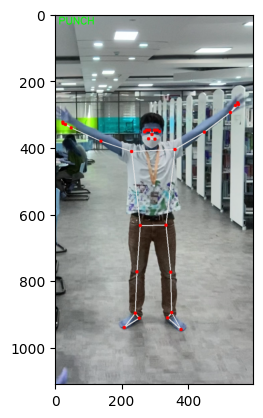

Start detect....
(1, 10, 132)
0 x: 0.48750510811805725
y: 0.3250100016593933
z: -0.48487475514411926
visibility: 0.9998980760574341

1 x: 0.4986143112182617
y: 0.31309184432029724
z: -0.4498515725135803
visibility: 0.999808669090271

2 x: 0.5066600441932678
y: 0.31322506070137024
z: -0.4498628079891205
visibility: 0.9997304677963257

3 x: 0.5139634609222412
y: 0.3134153485298157
z: -0.44995781779289246
visibility: 0.9997662305831909

4 x: 0.4756462574005127
y: 0.3128843307495117
z: -0.4531007409095764
visibility: 0.9998157620429993

5 x: 0.4680328965187073
y: 0.31287920475006104
z: -0.45308127999305725
visibility: 0.9997294545173645

6 x: 0.4608694911003113
y: 0.3130260109901428
z: -0.4530033469200134
visibility: 0.9997912049293518

7 x: 0.5263469815254211
y: 0.31764739751815796
z: -0.23580630123615265
visibility: 0.9996606707572937

8 x: 0.4500666856765747
y: 0.31765446066856384
z: -0.2562335133552551
visibility: 0.9997977614402771

9 x: 0.5034719109535217
y: 0.3376517593860626
z: -0.

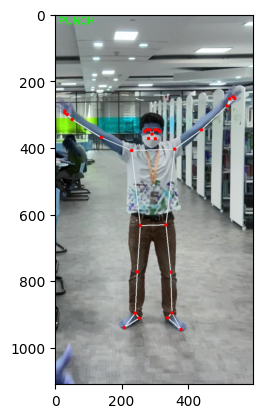

Start detect....
0 x: 0.4874815046787262
y: 0.32606688141822815
z: -0.4426504671573639
visibility: 0.9999069571495056

1 x: 0.4986993670463562
y: 0.31351882219314575
z: -0.4113377034664154
visibility: 0.9998234510421753

2 x: 0.5068092346191406
y: 0.31356197595596313
z: -0.4113292992115021
visibility: 0.999751627445221

3 x: 0.5142056345939636
y: 0.31367602944374084
z: -0.41146188974380493
visibility: 0.9997831583023071

4 x: 0.47563278675079346
y: 0.3134268820285797
z: -0.4112450182437897
visibility: 0.9998310804367065

5 x: 0.4679635167121887
y: 0.313405841588974
z: -0.41124120354652405
visibility: 0.9997525811195374

6 x: 0.46070563793182373
y: 0.3135264217853546
z: -0.4111579954624176
visibility: 0.9998081922531128

7 x: 0.5265066623687744
y: 0.3176540434360504
z: -0.21575820446014404
visibility: 0.9996854066848755

8 x: 0.4500596225261688
y: 0.3176848292350769
z: -0.21878118813037872
visibility: 0.9998142719268799

9 x: 0.5035088062286377
y: 0.33789771795272827
z: -0.3669262826442

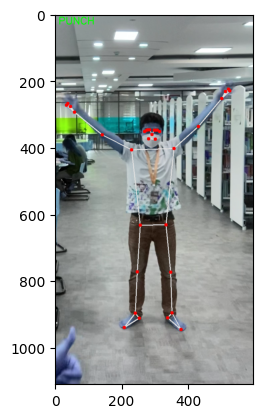

Start detect....
0 x: 0.4879755675792694
y: 0.3271235525608063
z: -0.4561367630958557
visibility: 0.99991375207901

1 x: 0.4991122782230377
y: 0.31420212984085083
z: -0.42443159222602844
visibility: 0.999833345413208

2 x: 0.5071529746055603
y: 0.3140353262424469
z: -0.424418568611145
visibility: 0.9997662305831909

3 x: 0.5145825147628784
y: 0.31396639347076416
z: -0.42467939853668213
visibility: 0.9997938871383667

4 x: 0.47617197036743164
y: 0.314397931098938
z: -0.4278605580329895
visibility: 0.9998418092727661

5 x: 0.4686756134033203
y: 0.3143724203109741
z: -0.4278404414653778
visibility: 0.9997689723968506

6 x: 0.4614977240562439
y: 0.3144584596157074
z: -0.42769742012023926
visibility: 0.999819278717041

7 x: 0.526553213596344
y: 0.31763574481010437
z: -0.23336660861968994
visibility: 0.9996997714042664

8 x: 0.450814425945282
y: 0.3176977336406708
z: -0.24251705408096313
visibility: 0.9998246431350708

9 x: 0.5040156245231628
y: 0.3380095064640045
z: -0.3802857995033264
visi

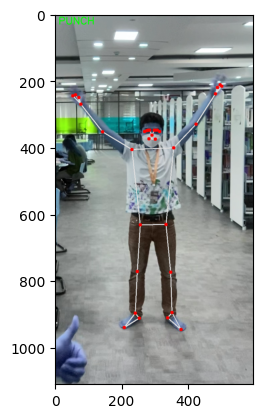

Start detect....
0 x: 0.4874759614467621
y: 0.3268515169620514
z: -0.49653732776641846
visibility: 0.9999195337295532

1 x: 0.4987199008464813
y: 0.31387826800346375
z: -0.4644923806190491
visibility: 0.9998432397842407

2 x: 0.5068139433860779
y: 0.3136375844478607
z: -0.4644261300563812
visibility: 0.9997805953025818

3 x: 0.5144840478897095
y: 0.31349804997444153
z: -0.4645894169807434
visibility: 0.9998046159744263

4 x: 0.47615721821784973
y: 0.31420978903770447
z: -0.4622442126274109
visibility: 0.9998522400856018

5 x: 0.4687443673610687
y: 0.3141914904117584
z: -0.4622695744037628
visibility: 0.9997850656509399

6 x: 0.4618629515171051
y: 0.31427237391471863
z: -0.46218201518058777
visibility: 0.9998306035995483

7 x: 0.5266614556312561
y: 0.3168353736400604
z: -0.2747690677642822
visibility: 0.9997144341468811

8 x: 0.4529009759426117
y: 0.3168454170227051
z: -0.264607310295105
visibility: 0.9998346567153931

9 x: 0.5035845041275024
y: 0.3369479179382324
z: -0.4231456816196441

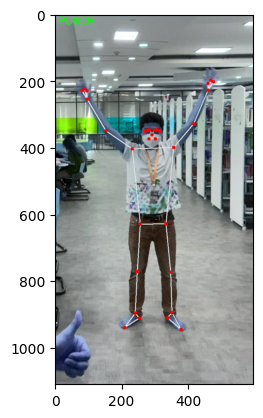

Start detect....
0 x: 0.48746156692504883
y: 0.3276066482067108
z: -0.501966655254364
visibility: 0.9999237060546875

1 x: 0.4987223446369171
y: 0.31515008211135864
z: -0.4661940038204193
visibility: 0.9998510479927063

2 x: 0.5068120956420898
y: 0.31476011872291565
z: -0.4661054015159607
visibility: 0.9997908473014832

3 x: 0.5145158767700195
y: 0.3144485652446747
z: -0.46626752614974976
visibility: 0.9998129606246948

4 x: 0.476132333278656
y: 0.31600654125213623
z: -0.46469807624816895
visibility: 0.9998607039451599

5 x: 0.4686342775821686
y: 0.31616121530532837
z: -0.46473416686058044
visibility: 0.9997976422309875

6 x: 0.4614664912223816
y: 0.3162766098976135
z: -0.46465492248535156
visibility: 0.999840259552002

7 x: 0.5266298651695251
y: 0.3170934319496155
z: -0.2721154987812042
visibility: 0.999722421169281

8 x: 0.4514504671096802
y: 0.31768280267715454
z: -0.2663998603820801
visibility: 0.9998431205749512

9 x: 0.503576397895813
y: 0.3370160758495331
z: -0.42864638566970825

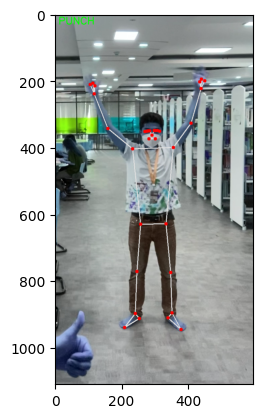

Start detect....
0 x: 0.4876669645309448
y: 0.32758793234825134
z: -0.44855996966362
visibility: 0.99992436170578

1 x: 0.49887874722480774
y: 0.3152081072330475
z: -0.40465861558914185
visibility: 0.9998531937599182

2 x: 0.506891667842865
y: 0.31483104825019836
z: -0.40458813309669495
visibility: 0.9997900128364563

3 x: 0.5146142244338989
y: 0.31453508138656616
z: -0.40472960472106934
visibility: 0.9998131990432739

4 x: 0.4763612747192383
y: 0.3161119222640991
z: -0.40300044417381287
visibility: 0.9998648762702942

5 x: 0.46892547607421875
y: 0.3163403868675232
z: -0.4030407667160034
visibility: 0.9998030662536621

6 x: 0.46174466609954834
y: 0.31652602553367615
z: -0.403011292219162
visibility: 0.9998461008071899

7 x: 0.5265876054763794
y: 0.3171094059944153
z: -0.20340248942375183
visibility: 0.999707818031311

8 x: 0.45158201456069946
y: 0.3177239000797272
z: -0.1970081627368927
visibility: 0.9998462796211243

9 x: 0.5036202073097229
y: 0.33692532777786255
z: -0.376551210880279

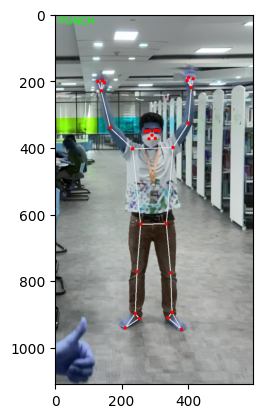

Start detect....
0 x: 0.4881978929042816
y: 0.3245987594127655
z: -0.44579288363456726
visibility: 0.9999241828918457

1 x: 0.49940726161003113
y: 0.31343263387680054
z: -0.3976030945777893
visibility: 0.9998557567596436

2 x: 0.5075833797454834
y: 0.313158243894577
z: -0.39751821756362915
visibility: 0.9997907876968384

3 x: 0.5157168507575989
y: 0.31298738718032837
z: -0.39763593673706055
visibility: 0.9998155236244202

4 x: 0.4767557978630066
y: 0.31484100222587585
z: -0.3951338231563568
visibility: 0.9998682141304016

5 x: 0.46937617659568787
y: 0.3154531419277191
z: -0.39519596099853516
visibility: 0.9998072385787964

6 x: 0.4622913897037506
y: 0.31595730781555176
z: -0.39517131447792053
visibility: 0.9998508095741272

7 x: 0.527481198310852
y: 0.31652966141700745
z: -0.1889883428812027
visibility: 0.9997003078460693

8 x: 0.45165079832077026
y: 0.3174991011619568
z: -0.1776506006717682
visibility: 0.9998490810394287

9 x: 0.5044602751731873
y: 0.33350637555122375
z: -0.3726984262

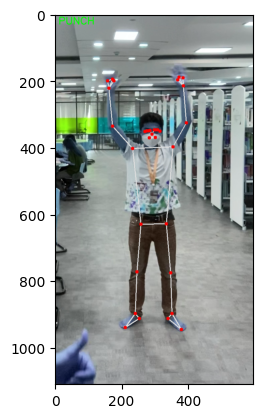

Start detect....
0 x: 0.48875692486763
y: 0.32315635681152344
z: -0.4170476198196411
visibility: 0.9999191164970398

1 x: 0.49961790442466736
y: 0.3123096227645874
z: -0.36540865898132324
visibility: 0.9998478293418884

2 x: 0.5077104568481445
y: 0.3119378387928009
z: -0.36531534790992737
visibility: 0.9997747540473938

3 x: 0.5158431529998779
y: 0.31165698170661926
z: -0.3653768002986908
visibility: 0.9998037219047546

4 x: 0.47727516293525696
y: 0.31395840644836426
z: -0.36157506704330444
visibility: 0.9998613595962524

5 x: 0.46988263726234436
y: 0.3146733045578003
z: -0.3616267442703247
visibility: 0.9997963309288025

6 x: 0.46280819177627563
y: 0.3152411878108978
z: -0.3616296648979187
visibility: 0.9998444318771362

7 x: 0.5273704528808594
y: 0.3160279095172882
z: -0.14775501191616058
visibility: 0.9996669888496399

8 x: 0.4516814053058624
y: 0.3167962431907654
z: -0.12877777218818665
visibility: 0.9998382329940796

9 x: 0.5045595765113831
y: 0.3316172957420349
z: -0.341318219900

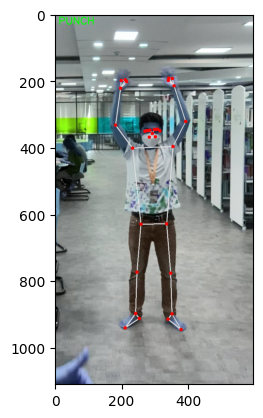

Start detect....
0 x: 0.48863083124160767
y: 0.3283527195453644
z: -0.43209055066108704
visibility: 0.9999040961265564

1 x: 0.49957147240638733
y: 0.31573060154914856
z: -0.38589972257614136
visibility: 0.9998248815536499

2 x: 0.5076382756233215
y: 0.3148762881755829
z: -0.38582202792167664
visibility: 0.9997353553771973

3 x: 0.515775740146637
y: 0.3141649663448334
z: -0.38589856028556824
visibility: 0.9997743964195251

4 x: 0.47681185603141785
y: 0.31738558411598206
z: -0.3785231411457062
visibility: 0.9998374581336975

5 x: 0.46910253167152405
y: 0.31756001710891724
z: -0.37854981422424316
visibility: 0.999755322933197

6 x: 0.46157601475715637
y: 0.3176993131637573
z: -0.37856215238571167
visibility: 0.9998161196708679

7 x: 0.5269677042961121
y: 0.31666702032089233
z: -0.17410653829574585
visibility: 0.9995986223220825

8 x: 0.4508773386478424
y: 0.3183816969394684
z: -0.1333138644695282
visibility: 0.9998047351837158

9 x: 0.5043371319770813
y: 0.33528411388397217
z: -0.3562673

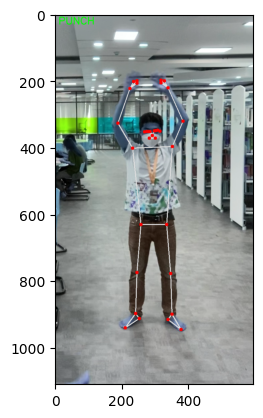

Start detect....
0 x: 0.4886099696159363
y: 0.33167776465415955
z: -0.5325021147727966
visibility: 0.9998501539230347

1 x: 0.4995114207267761
y: 0.317939430475235
z: -0.49022191762924194
visibility: 0.9997446537017822

2 x: 0.5075597763061523
y: 0.31686699390411377
z: -0.4901132881641388
visibility: 0.999602198600769

3 x: 0.515658438205719
y: 0.31598201394081116
z: -0.49019500613212585
visibility: 0.9996702075004578

4 x: 0.47594118118286133
y: 0.319540411233902
z: -0.482266366481781
visibility: 0.9997615218162537

5 x: 0.46734026074409485
y: 0.31934624910354614
z: -0.48231348395347595
visibility: 0.9996329545974731

6 x: 0.458827942609787
y: 0.31915631890296936
z: -0.48238614201545715
visibility: 0.9997323155403137

7 x: 0.5263243317604065
y: 0.3173990845680237
z: -0.2664819359779358
visibility: 0.9993648529052734

8 x: 0.44885239005088806
y: 0.31917130947113037
z: -0.2242085039615631
visibility: 0.9997091889381409

9 x: 0.5042665004730225
y: 0.33841177821159363
z: -0.44856339693069

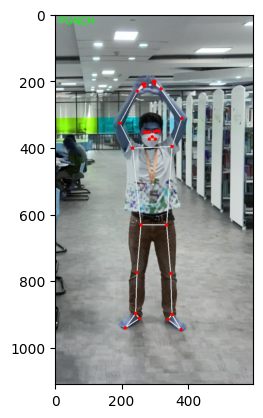

Start detect....
(1, 10, 132)0 x: 0.4885680377483368
y: 0.33319786190986633
z: -0.5392241477966309
visibility: 0.9997994303703308

1 x: 0.49937868118286133
y: 0.3191021680831909
z: -0.4999995827674866
visibility: 0.9996719360351562

2 x: 0.5074448585510254
y: 0.3180120289325714
z: -0.49985477328300476
visibility: 0.9994785785675049

3 x: 0.5154954195022583
y: 0.3170850872993469
z: -0.49992451071739197
visibility: 0.9995681047439575

4 x: 0.47480928897857666
y: 0.3205806016921997
z: -0.4973401427268982
visibility: 0.999695360660553

5 x: 0.4655379354953766
y: 0.32029545307159424
z: -0.4974343776702881
visibility: 0.9995354413986206

6 x: 0.4565175771713257
y: 0.3200128972530365
z: -0.49752330780029297
visibility: 0.9996686577796936

7 x: 0.5251056551933289
y: 0.3180577754974365
z: -0.2722824811935425
visibility: 0.999194324016571

8 x: 0.44667333364486694
y: 0.32045412063598633
z: -0.25626564025878906
visibility: 0.9996376037597656

9 x: 0.5042598843574524
y: 0.34015393257141113
z: -0.4

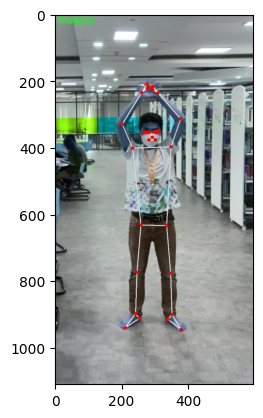

Start detect....
0 x: 0.48878198862075806
y: 0.33296939730644226
z: -0.4705330729484558
visibility: 0.9997952580451965

1 x: 0.49982303380966187
y: 0.31900912523269653
z: -0.43118029832839966
visibility: 0.9996727108955383

2 x: 0.5078772902488708
y: 0.317949503660202
z: -0.4309965670108795
visibility: 0.9994760155677795

3 x: 0.5158480405807495
y: 0.3169611990451813
z: -0.4309775233268738
visibility: 0.999563992023468

4 x: 0.4749523997306824
y: 0.3197614550590515
z: -0.43276819586753845
visibility: 0.999696671962738

5 x: 0.46560224890708923
y: 0.31923994421958923
z: -0.43290141224861145
visibility: 0.9995411038398743

6 x: 0.4565557837486267
y: 0.31869179010391235
z: -0.4330340027809143
visibility: 0.9996747374534607

7 x: 0.5251003503799438
y: 0.31789112091064453
z: -0.19827207922935486
visibility: 0.999207079410553

8 x: 0.4466981887817383
y: 0.3199557662010193
z: -0.20219695568084717
visibility: 0.9996502995491028

9 x: 0.5044648051261902
y: 0.340091347694397
z: -0.38166147470474

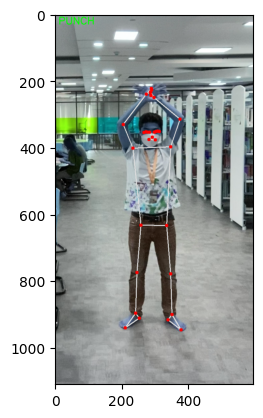

Start detect....
0 x: 0.48894035816192627
y: 0.33258742094039917
z: -0.4255237877368927
visibility: 0.9997976422309875

1 x: 0.5006477236747742
y: 0.31895121932029724
z: -0.38577786087989807
visibility: 0.99968022108078

2 x: 0.5087963342666626
y: 0.3178797960281372
z: -0.38561904430389404
visibility: 0.9994857907295227

3 x: 0.5167542695999146
y: 0.3169030249118805
z: -0.38559240102767944
visibility: 0.9995718598365784

4 x: 0.475140243768692
y: 0.3191203474998474
z: -0.38889315724372864
visibility: 0.9997031092643738

5 x: 0.46570295095443726
y: 0.318492591381073
z: -0.3889836072921753
visibility: 0.9995530843734741

6 x: 0.45661768317222595
y: 0.31783896684646606
z: -0.38905373215675354
visibility: 0.9996843338012695

7 x: 0.5254231095314026
y: 0.3178881108760834
z: -0.15709909796714783
visibility: 0.9992368221282959

8 x: 0.44667771458625793
y: 0.31954681873321533
z: -0.1703711748123169
visibility: 0.9996658563613892

9 x: 0.5046870708465576
y: 0.33998337388038635
z: -0.33854675292

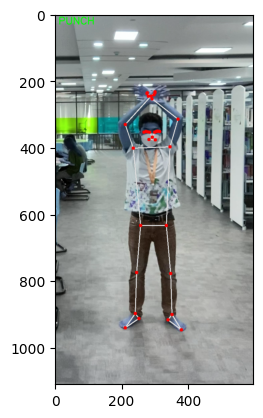

Start detect....
0 x: 0.4898764193058014
y: 0.3324640095233917
z: -0.4081747829914093
visibility: 0.9998072981834412

1 x: 0.5026102066040039
y: 0.3191733956336975
z: -0.369992196559906
visibility: 0.999697744846344

2 x: 0.510995090007782
y: 0.3183782994747162
z: -0.36985352635383606
visibility: 0.99951171875

3 x: 0.5190797448158264
y: 0.31760141253471375
z: -0.36984753608703613
visibility: 0.9995939135551453

4 x: 0.47570574283599854
y: 0.31913232803344727
z: -0.3728378713130951
visibility: 0.9997193813323975

5 x: 0.46585988998413086
y: 0.3185529410839081
z: -0.37290218472480774
visibility: 0.9995774626731873

6 x: 0.45666584372520447
y: 0.3179294764995575
z: -0.3729250133037567
visibility: 0.9997027516365051

7 x: 0.527529776096344
y: 0.3187800347805023
z: -0.14486251771450043
visibility: 0.9992825984954834

8 x: 0.446529358625412
y: 0.319610595703125
z: -0.15743307769298553
visibility: 0.9996885657310486

9 x: 0.5057088136672974
y: 0.3403085470199585
z: -0.3220241367816925
visibi

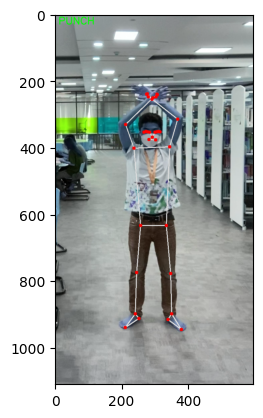

Start detect....
0 x: 0.4898753762245178
y: 0.33228784799575806
z: -0.3405021131038666
visibility: 0.9997542500495911

1 x: 0.5026349425315857
y: 0.31922268867492676
z: -0.3023715317249298
visibility: 0.9996013641357422

2 x: 0.5109955072402954
y: 0.3185785114765167
z: -0.30225175619125366
visibility: 0.999342679977417

3 x: 0.5190359354019165
y: 0.3179347813129425
z: -0.3023029863834381
visibility: 0.9994756579399109

4 x: 0.4757053554058075
y: 0.31909748911857605
z: -0.30559033155441284
visibility: 0.9996331334114075

5 x: 0.4658633768558502
y: 0.3185378313064575
z: -0.3056395947933197
visibility: 0.9994490146636963

6 x: 0.45669370889663696
y: 0.3179266154766083
z: -0.3057267963886261
visibility: 0.9996329545974731

7 x: 0.5275059938430786
y: 0.31909963488578796
z: -0.09444662183523178
visibility: 0.9991115927696228

8 x: 0.44654953479766846
y: 0.31957322359085083
z: -0.10564354062080383
visibility: 0.9996286630630493

9 x: 0.5057263970375061
y: 0.3402150869369507
z: -0.260878592729

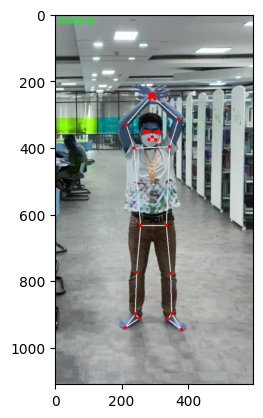

Start detect....
0 x: 0.49063828587532043
y: 0.3323405086994171
z: -0.3787136375904083
visibility: 0.9997294545173645

1 x: 0.5029282569885254
y: 0.31930193305015564
z: -0.3392771780490875
visibility: 0.9995624423027039

2 x: 0.5111870765686035
y: 0.31868496537208557
z: -0.3391619920730591
visibility: 0.9992721676826477

3 x: 0.5191037058830261
y: 0.3180350363254547
z: -0.33921483159065247
visibility: 0.9994215965270996

4 x: 0.4757947325706482
y: 0.31914910674095154
z: -0.34002891182899475
visibility: 0.9995975494384766

5 x: 0.4659007489681244
y: 0.31860142946243286
z: -0.3400892913341522
visibility: 0.9993941783905029

6 x: 0.45671752095222473
y: 0.3180088996887207
z: -0.3401750326156616
visibility: 0.9996024966239929

7 x: 0.5274856090545654
y: 0.31908926367759705
z: -0.1254166066646576
visibility: 0.9990487098693848

8 x: 0.4462708830833435
y: 0.31958210468292236
z: -0.12613850831985474
visibility: 0.9996066689491272

9 x: 0.5064256191253662
y: 0.34020453691482544
z: -0.2975596189

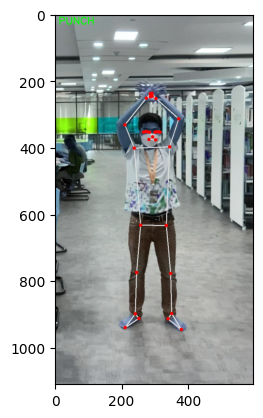

Start detect....
0 x: 0.4918084740638733
y: 0.3322452902793884
z: -0.40274888277053833
visibility: 0.9997271299362183

1 x: 0.5031525492668152
y: 0.3192416727542877
z: -0.3601449131965637
visibility: 0.9995613098144531

2 x: 0.511282205581665
y: 0.3186478316783905
z: -0.36005738377571106
visibility: 0.9992690682411194

3 x: 0.5190992951393127
y: 0.3180010914802551
z: -0.3601323366165161
visibility: 0.9994198679924011

4 x: 0.47600656747817993
y: 0.3191869854927063
z: -0.3588484525680542
visibility: 0.999596357345581

5 x: 0.4659997224807739
y: 0.3186849355697632
z: -0.3589046597480774
visibility: 0.9993894100189209

6 x: 0.4567357897758484
y: 0.3181191086769104
z: -0.359036922454834
visibility: 0.9995989799499512

7 x: 0.5272102952003479
y: 0.3185550570487976
z: -0.14733445644378662
visibility: 0.999049186706543

8 x: 0.4460529088973999
y: 0.31937626004219055
z: -0.1376556009054184
visibility: 0.9996036291122437

9 x: 0.5071715712547302
y: 0.33999601006507874
z: -0.3230772614479065
vis

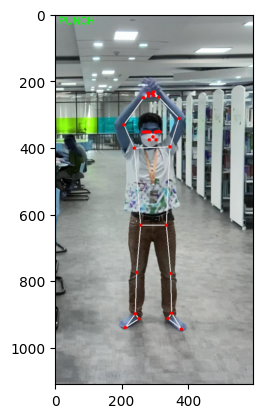

Start detect....
0 x: 0.4918406307697296
y: 0.33219215273857117
z: -0.4119950532913208
visibility: 0.9997205138206482

1 x: 0.5029773116111755
y: 0.3192219138145447
z: -0.3686486780643463
visibility: 0.9995517134666443

2 x: 0.5110569000244141
y: 0.31858962774276733
z: -0.36861759424209595
visibility: 0.9992521405220032

3 x: 0.5188167691230774
y: 0.3178829848766327
z: -0.36876705288887024
visibility: 0.999411940574646

4 x: 0.47597718238830566
y: 0.3191666007041931
z: -0.3599887192249298
visibility: 0.9995844960212708

5 x: 0.46601077914237976
y: 0.3186870813369751
z: -0.3599545657634735
visibility: 0.9993627667427063

6 x: 0.45676544308662415
y: 0.31813812255859375
z: -0.36009082198143005
visibility: 0.9995800852775574

7 x: 0.5265023112297058
y: 0.3176662027835846
z: -0.16639278829097748
visibility: 0.9990238547325134

8 x: 0.4460259675979614
y: 0.3186027705669403
z: -0.14595718681812286
visibility: 0.9995821118354797

9 x: 0.5072404146194458
y: 0.3398160934448242
z: -0.337220191955

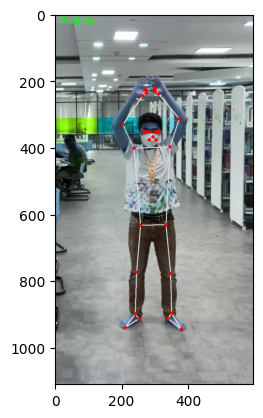

In [ ]:
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

i = 0
warmup_frames = 60

# Tải video từ file
cap = cv2.VideoCapture('/content/UpHand.mp4')

# Kiểm tra xem video có được mở không
if not cap.isOpened():
    print("Không thể mở video")

# Lấy thông tin về video
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

# Tạo VideoWriter
out = cv2.VideoWriter('output.avi', cv2.VideoWriter_fourcc('M','J','P','G'), 10, (frame_width,frame_height))

while True:
    # Đọc frame từ video
    success, img = cap.read()

    # Nếu không còn frame để đọc -> kết thúc vòng lặp
    if not success:
        break

    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = pose.process(imgRGB)
    i = i + 1
    if i > warmup_frames:
        print("Start detect....")

        if results.pose_landmarks:
            c_lm = make_landmark_timestep(results)

            lm_list.append(c_lm)
            if len(lm_list) == n_time_steps:
                # predict
                t1 = threading.Thread(target=detect, args=(model, lm_list,))
                t1.start()
                lm_list = []

            img = draw_landmark_on_image(mpDraw, results, img)

    img = draw_class_on_image(label, img)

    # Lưu frame vào file video
    out.write(img)

    # Hiển thị hình ảnh sử dụng matplotlib
    plt.imshow(img)
    plt.show()

    # Thoát vòng lặp khi nhấn 'q'
    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Tạo VideoWriter
out = cv2.VideoWriter('/content/drive/MyDrive/HAR/output.avi', cv2.VideoWriter_fourcc('M','J','P','G'), 10, (frame_width,frame_height))


In [ ]:
import shutil

source = '/content/output.avi'
destination = '/content/drive/MyDrive/HAR/output.avi'

shutil.move(source, destination)


'/content/drive/MyDrive/HAR/output.avi'

In [ ]:
!pip install --upgrade mediapipe


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import cv2
import mediapipe as mp
import numpy as np

mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

# Initialize people detector and pose model
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
pose = mp_pose.Pose(min_detection_confidence=0.5, min_tracking_confidence=0.5)
vio="/content/IMG_3620.mp4"
cap = cv2.VideoCapture(vio)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
out = cv2.VideoWriter('/content/output.avi', cv2.VideoWriter_fourcc('M','J','P','G'), 10, (frame_width,frame_height))

while cap.isOpened():
    success, image = cap.read()
    if not success:
        print("Ignoring empty camera frame.")
        continue

    # Detect people in the image
    boxes, weights = hog.detectMultiScale(image, winStride=(4, 4), padding=(8, 8), scale=1.05)
    
    # Process each detected person
    for (x, y, w, h) in boxes:
        # Crop the person from the image
        person = image[y:y+h, x:x+w]
        # Process the person to get pose landmarks
        results = pose.process(cv2.cvtColor(person, cv2.COLOR_BGR2RGB))
        if results.pose_landmarks:
            # Draw the pose landmarks on the person
            mp_drawing.draw_landmarks(
                person, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
            # Paste the person back into the image
            image[y:y+h, x:x+w] = person

    # Write the frame into the output file
    out.write(image)
    
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()


Streaming output truncated to the last 5000 lines.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera frame.
Ignoring empty camera

In [ ]:
import cv2
import mediapipe as mp
import numpy as np

mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

# Initialize people detector and pose model
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
pose = mp_pose.Pose(min_detection_confidence=0.5, min_tracking_confidence=0.5)
vio="/content/IMG_3620.mp4"
cap = cv2.VideoCapture(vio)
while cap.isOpened():
    success, image = cap.read()
    if not success:
        print("Ignoring empty camera frame.")
        continue

    # Detect people in the image
    boxes, weights = hog.detectMultiScale(image, winStride=(4, 4), padding=(8, 8), scale=1.05)
    
    # Process each detected person
    for (x, y, w, h) in boxes:
        # Crop the person from the image
        person = image[y:y+h, x:x+w]
        # Process the person to get pose landmarks
        results = pose.process(cv2.cvtColor(person, cv2.COLOR_BGR2RGB))
        if results.pose_landmarks:
            # Draw the pose landmarks on the person
            mp_drawing.draw_landmarks(
                person, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
            # Paste the person back into the image
            image[y:y+h, x:x+w] = person

    # Display the image
    cv2.imshow('MediaPipe Pose', image)
    if cv2.waitKey(5) & 0xFF == 27:
        break
cap.release()


DisabledFunctionError: ignored